In [1]:
import episcanpy as epi
import anndata as ad
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import scanpy.external as sce


sc.set_figure_params(scanpy=True, dpi=80, dpi_save=250,
                     frameon=True, vector_friendly=True,
                     color_map="YlGnBu", format='pdf', transparent=False,
                     ipython_format='png2x')

In [ ]:
DATADIR = ''

In [73]:
adata = ad.read('10x_only_10k_cells_pbmc_macs2_processed_not_log1p.h5ad')
adata

AnnData object with n_obs × n_vars = 9891 × 75226
    obs: 'nb_features', 'log_nb_features', 'n_counts', 'louvain'
    var: 'n_cells', 'commonness', 'prop_shared_cells', 'variability_score'
    uns: 'louvain', 'louvain_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

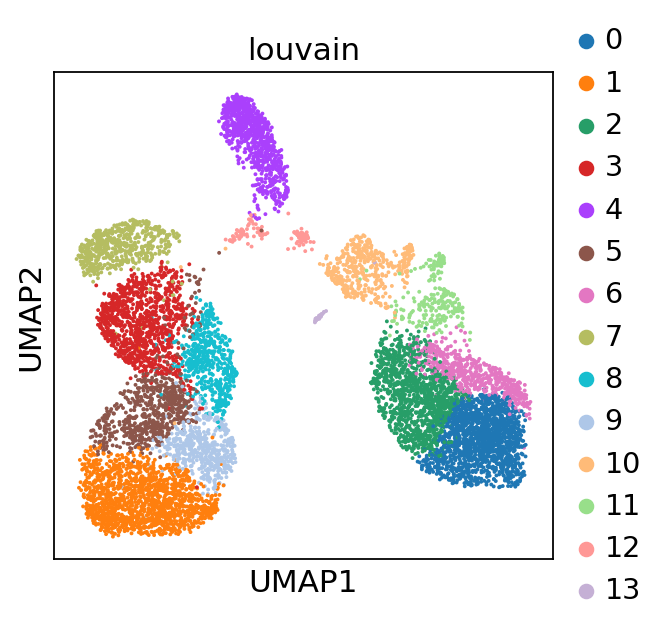

In [74]:
sc.pl.umap(adata, color='louvain')

In [5]:
sc.pp.log1p(adata)

In [6]:
epi.pp.lazy(adata)

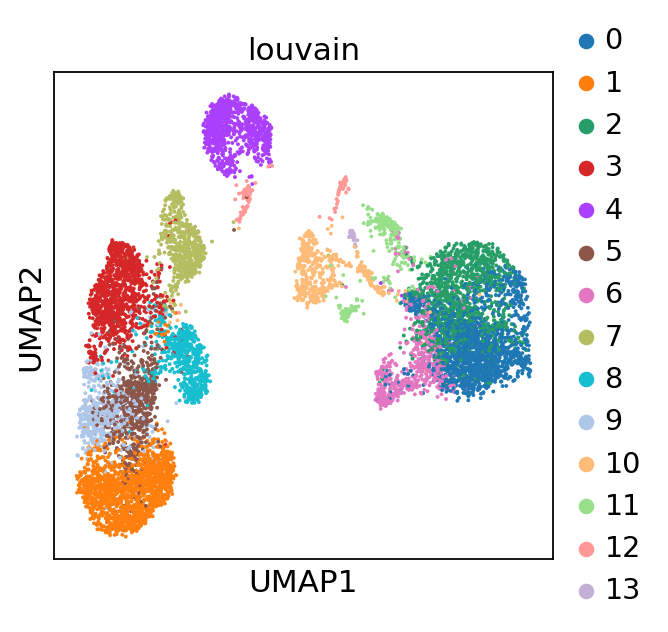

In [7]:
sc.pl.umap(adata, color='louvain')

# cell label transfer

In [8]:
# 10x data
adata10 = ad.read(DATADIR+'processed_10x_log1p_pre_integration_with_greenleaf.h5ad')
adata10.obs['dataset'] = ['10x Genomics' for n in adata10.obs_names.tolist()]
adata10

AnnData object with n_obs × n_vars = 10234 × 150513
    obs: 'nb_features', 'log_nb_features', 'n_counts', 'louvain', 'dataset'
    var: 'n_cells', 'commonness', 'prop_shared_cells', 'variability_score'
    uns: 'louvain', 'louvain_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

... storing 'dataset' as categorical


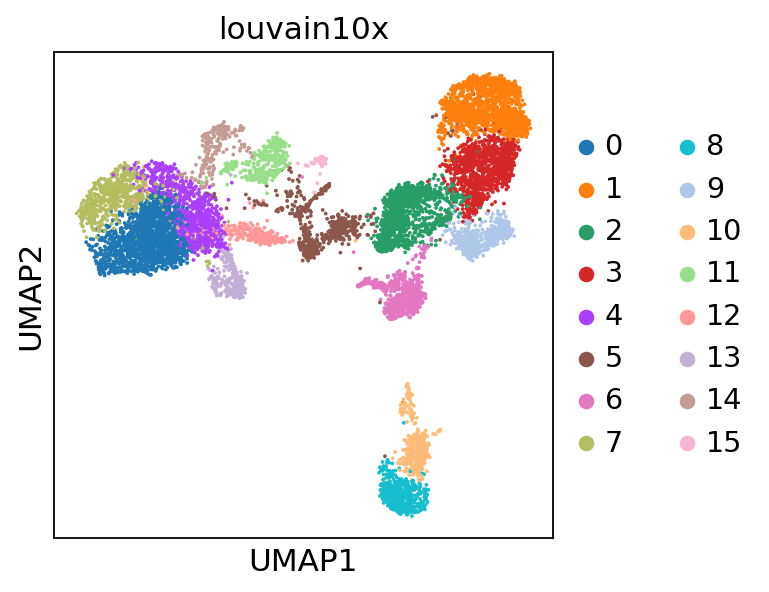

In [9]:
sc.tl.louvain(adata10, resolution=1,key_added='louvain10x')
sc.pl.umap(adata10, color=['louvain10x'])

... storing '10x_cell_type_annot' as categorical


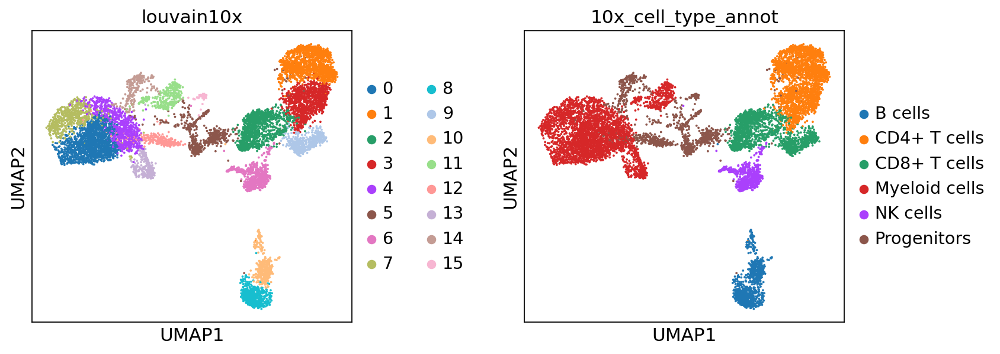

In [10]:
annot = []
for n in adata10.obs['louvain10x']:
    if n in ['5', '15', '14', '12']:
        annot.append('Progenitors')
    elif n in ['6']:
        annot.append('NK cells')
    elif n in ['0', '4', '7', '13', '11']:
        annot.append('Myeloid cells')
    elif n in ['8', '10']:
        annot.append('B cells')
    elif n in []:
        annot.append('Basophils')
    elif n in ['3', '1']:
        annot.append('CD4+ T cells')
    elif n in ['9', '2']:
        annot.append('CD8+ T cells')
    else:
        annot.append(n)
        
adata10.obs['10x_cell_type_annot'] = annot
sc.pl.umap(adata10, color=['louvain10x', '10x_cell_type_annot'], wspace=0.4)
adata10.obs['broad_annot'] = adata10.obs['10x_cell_type_annot'].copy()

In [11]:
celltype = {}
index =0
for n in adata10.obs_names.tolist():
    celltype[n] = adata10.obs['10x_cell_type_annot'][index]
    index += 1

annot = []
index =0
for n in adata.obs_names.tolist():
    if n in celltype.keys():
        annot.append(celltype[n])
    else:
        annot.append(adata.obs['louvain'][index])
    index +=1
    
adata.obs['10x_cell_type_annot'] = annot

In [12]:
set(adata.obs['10x_cell_type_annot'])

{'B cells',
 'CD4+ T cells',
 'CD8+ T cells',
 'Myeloid cells',
 'NK cells',
 'Progenitors'}

... storing '10x_cell_type_annot' as categorical


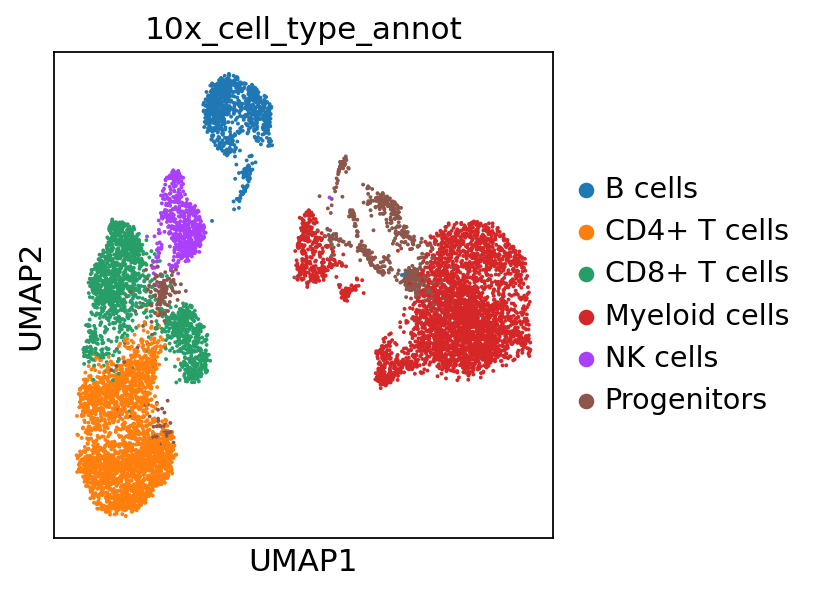

In [13]:
sc.pl.umap(adata, color='10x_cell_type_annot', save='10x_only_cell_types.png')

# cell color transfer

In [95]:
path = ''
adata1 = ad.read(path+"Greenleaf_large_processed_annot_from_their_paper.h5ad")
adata1

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


AnnData object with n_obs × n_vars = 57177 × 83823
    obs: 'UMAP1', 'UMAP2', 'Clusters', 'Group', 'depth', 'FRIP', 'Internal_Name', 'Group_Barcode', 'nb_features', 'log_nb_features', 'n_counts', 'broad_annot', 'leiden', 'cell_types'
    var: 'n_cells', 'prop_shared_cells', 'variability_score'
    uns: 'Internal_Name_colors', 'broad_annot_colors', 'cell_types_colors', 'leiden', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [96]:
annot = []
for elem in adata1.obs["Clusters"]:
    if elem in ["Cluster1","Cluster2","Cluster3","Cluster4","Cluster5",
                "Cluster6","Cluster7","Cluster8","Cluster9"]:
        annot.append("Progenitors")
    elif elem in ["Cluster10","Cluster11","Cluster12","Cluster13"]:
        annot.append("Myeloid cells")
    elif elem in ["Cluster14","Cluster15","Cluster16"]:
        annot.append("B cells")
    elif elem in ["Cluster17"]:
        annot.append("Basophils")
    elif elem in ["Cluster18","Cluster19","Cluster20"]:
        annot.append("NK cells")
    elif elem in ["Cluster21","Cluster22","Cluster23","Cluster24","Cluster25"]:
        annot.append("CD4+ T cells")
    elif elem in ["Cluster26","Cluster27","Cluster28","Cluster29","Cluster30","Cluster31"]:
        annot.append("CD8+ T cells")
        
adata1.obs["broad_annot"] = annot

... storing 'broad_annot' as categorical


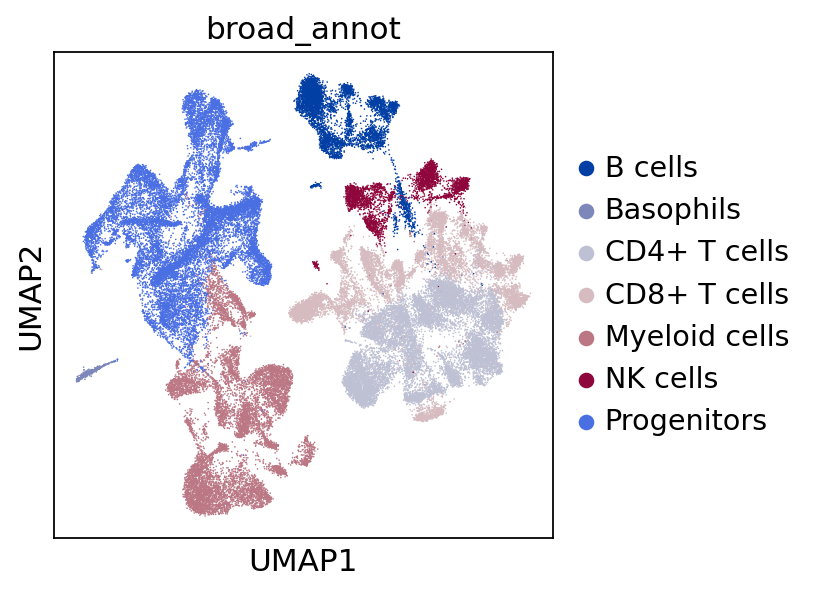

In [97]:
sc.pl.umap(adata1, color="broad_annot")

In [68]:
adata.uns['10x_cell_type_annot_colors'] = ['#023fa5', # Bcells
                                           '#bec1d4', # CD4
                                           '#d6bcc0', # CD8
                                           '#bb7784', # Myeloid
                                           '#8e063b', # NK cells
                                          '#4a6fe3', # Progenitors
                                          ]

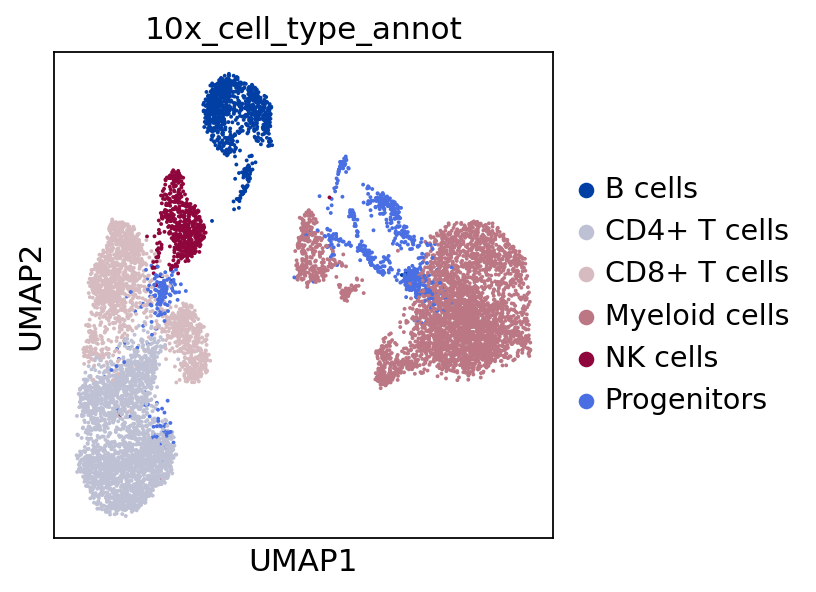

In [72]:
sc.pl.umap(adata, color=['10x_cell_type_annot'],
           save='10x_only_cell_types_colors.png')

In [71]:
adata.write('10x_only_10k_cells_pbmc_macs2_processed_log1p_correct_colors.h5ad')

In [74]:
del adata1

# marker plots

In [2]:
import anndata as ad

In [3]:
adata = ad.read('10x_only_10k_cells_pbmc_macs2_processed_log1p_correct_colors.h5ad')
adata

AnnData object with n_obs × n_vars = 9891 × 75226
    obs: 'nb_features', 'log_nb_features', 'n_counts', 'louvain', '10x_cell_type_annot'
    var: 'n_cells', 'commonness', 'prop_shared_cells', 'variability_score'
    uns: '10x_cell_type_annot_colors', 'broad_annot_colors', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [6]:
del adata.obs['nb_features'], adata.obs['log_nb_features']
del adata.obs['n_counts'], adata.obs['louvain']
adata.obs

,10x_cell_type_annot
AAACGAAAGAGCTGTG-1,Myeloid cells
AAACGAAAGCCTCGCA-1,B cells
AAACGAAAGCGAGCTA-1,Myeloid cells
AAACGAAAGCGCCTAC-1,NK cells
AAACGAAAGGGAGTTC-1,Myeloid cells
...,...
TTTGTGTTCCTAAGTG-1,CD4+ T cells
TTTGTGTTCCTGGAAT-1,Myeloid cells
TTTGTGTTCCTTTGAT-1,CD4+ T cells
TTTGTGTTCGCATACA-1,Myeloid cells


In [7]:
adata.write_csvs("10x_pbmc_atac_cell_type_annot")

writing .csv files to 10x_pbmc_atac_cell_type_annot


In [66]:
adatag = adata.copy()
adatag.X = adata.layers['counts']
adatag = epi.tl.geneactivity(adatag,
                             feature_type='transcript',
                             gtf_file =path+"gencode.v35.annotation.gtf")
adatag

AnnData object with n_obs × n_vars = 9891 × 5812
    obs: 'nb_features', 'log_nb_features', 'n_counts', 'louvain', '10x_cell_type_annot'
    var: 'gene_id', 'transcript_id', 'gene_type', 'gene_name', 'transcript_type', 'transcript_name', 'protein_id'
    uns: '10x_cell_type_annot_colors', 'broad_annot_colors', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    obsp: 'connectivities', 'distances'

In [75]:
adatag

AnnData object with n_obs × n_vars = 9891 × 5812
    obs: 'nb_features', 'log_nb_features', 'n_counts', 'louvain', '10x_cell_type_annot'
    var: 'gene_id', 'transcript_id', 'gene_type', 'gene_name', 'transcript_type', 'transcript_name', 'protein_id'
    uns: '10x_cell_type_annot_colors', 'broad_annot_colors', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    obsp: 'connectivities', 'distances'

In [ ]:
path = '/mnt/znas/icb_zstore01/scratch/users/anna.danese/MariaR/'
epi.tl.find_genes(adata,
                  path+"gencode.v35.annotation.gtf",
                  upstream=5000,
                  feature_type="transcript")

In [6]:
adatax = adata.copy()
adatax.var_names = adata.var["gene_annotation"]
adatax.raw = adatax

In [7]:
annot = []
for idx, elem in enumerate(adatax.var_names):
    annot.append(elem+"_"+str(idx))
adatax.var_names = annot    

In [8]:
adatax

AnnData object with n_obs × n_vars = 9891 × 75226
    obs: 'nb_features', 'log_nb_features', 'n_counts', 'louvain', '10x_cell_type_annot'
    var: 'n_cells', 'commonness', 'prop_shared_cells', 'variability_score', 'gene_annotation'
    uns: '10x_cell_type_annot_colors', 'broad_annot_colors', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [50]:
sc.tl.rank_genes_groups(adatax, "10x_cell_type_annot", use_raw=False)

... storing 'gene_annotation' as categorical


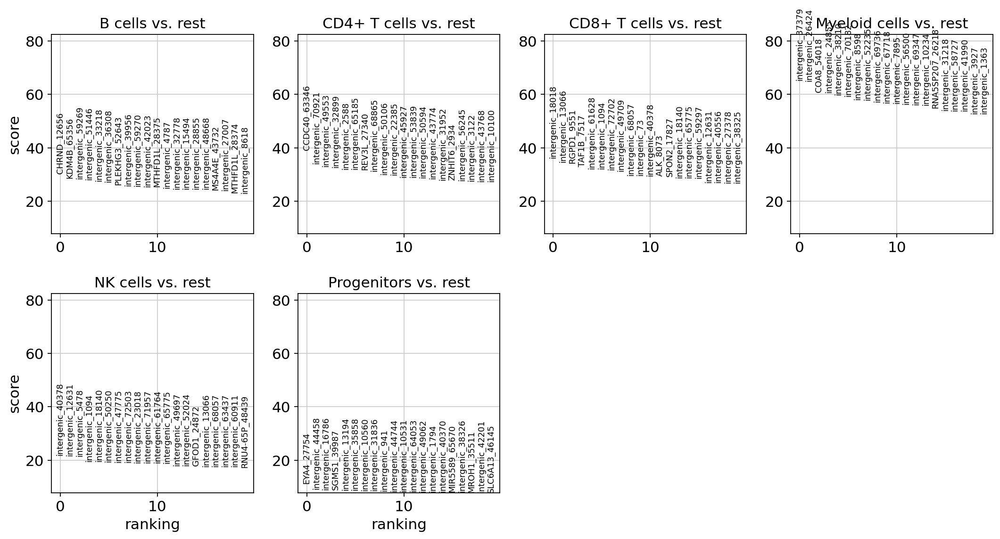

In [51]:
sc.pl.rank_genes_groups(adatax)

In [52]:
set(adata.obs['10x_cell_type_annot'])

{'B cells',
 'CD4+ T cells',
 'CD8+ T cells',
 'Myeloid cells',
 'NK cells',
 'Progenitors'}

In [9]:
small_marker_dict = {
 'B cells':['CHRND_12656', 'KDM4B_65356', 'PLEKHG3_52643'],
 'CD4+ T cells':['CCDC40_63346', 'REV3L_27340', 'ZNHIT6_2934'],
 'CD8+ T cells':['RGPD1_9551', 'TAF1B_7517', 'ALK_8073'],
 'Myeloid cells':['COA8_54018', 'RNA5SP207_26218', 'ABAT_57106'],
 'NK cells':['RNU4-65P_48439', 'GFOD1_24872', 'DMC1_72615'],
 'Progenitors':['EYA4_27754', 'SGMS1_39987', 'MIR5589_65670']}

In [10]:
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=250,
                     frameon=True, vector_friendly=True,
                     color_map="YlGnBu", format='pdf', transparent=False,
                     ipython_format='png2x')

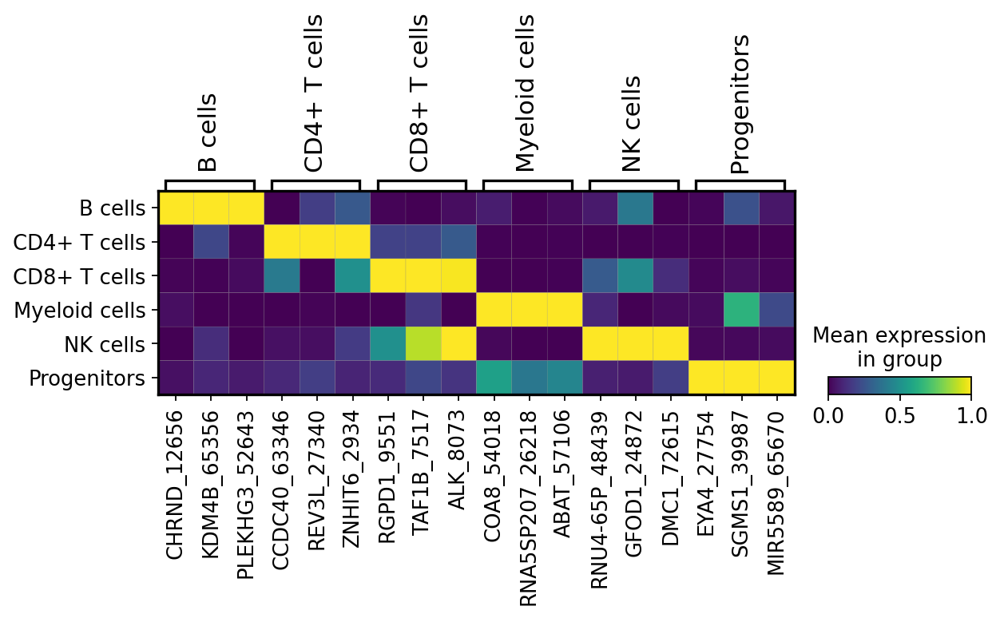

In [55]:
sc.pl.matrixplot(adatax, groupby="10x_cell_type_annot", var_names=small_marker_dict,
                     use_raw=False,
                     standard_scale="var", save="_markers_10x_Nov9_2020.png")

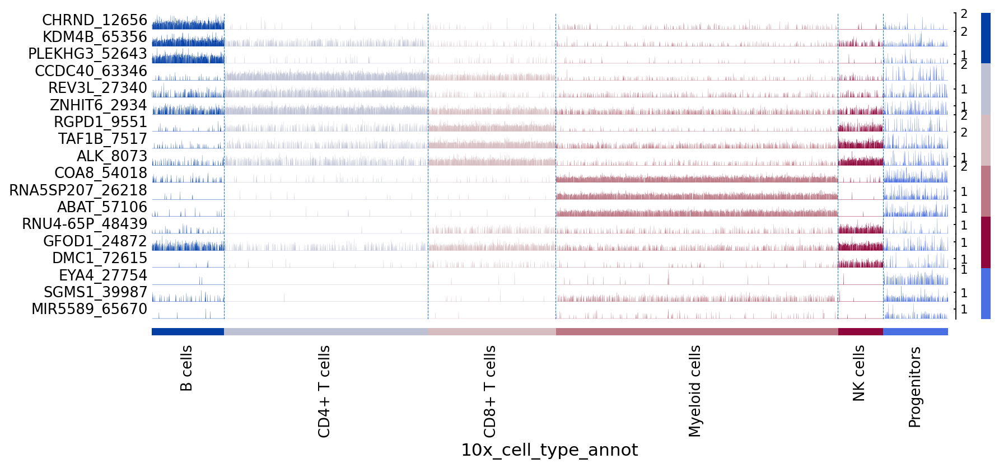

In [56]:
sc.pl.tracksplot(adatax, groupby="10x_cell_type_annot", var_names=small_marker_dict,
                     use_raw=False,
                     standard_scale="var", save="_markers_10x_Nov9_2020.png")

... storing 'gene_annotation' as categorical


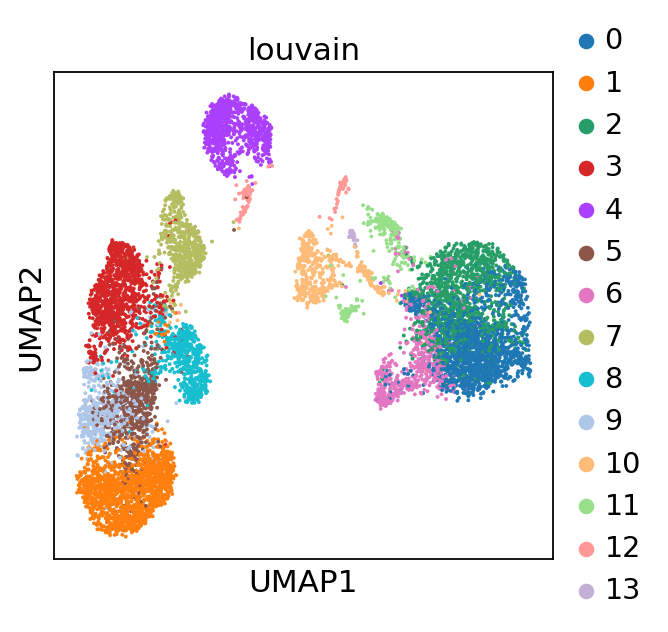

In [57]:
sc.pl.umap(adata, color='louvain', save='10x_only_louvain.png')

In [11]:
del adatax.layers['counts']

In [12]:
del adatax.raw

... storing 'gene_annotation' as categorical


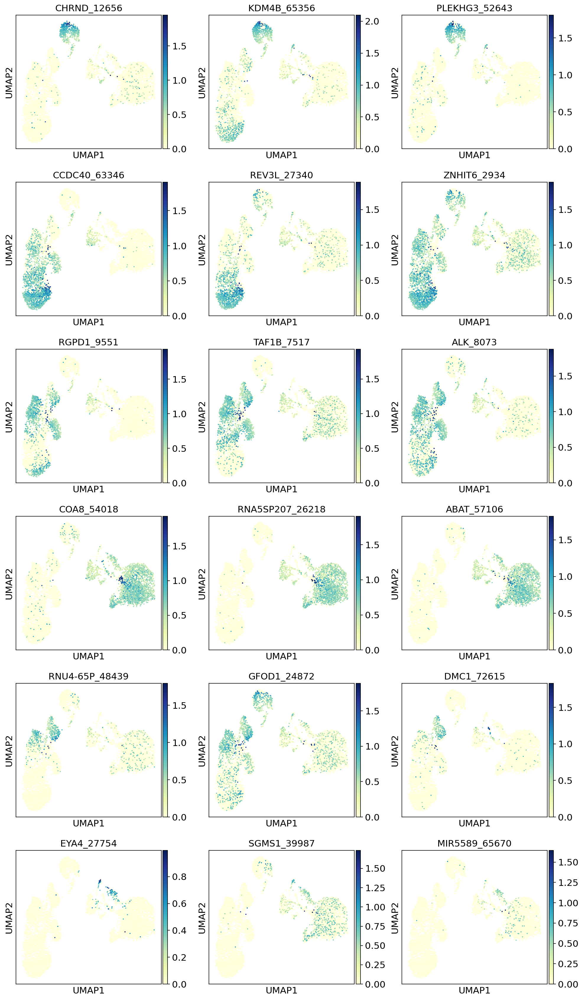

In [13]:
sc.pl.umap(adatax, color=['CHRND_12656', 'KDM4B_65356', 'PLEKHG3_52643',
                         'CCDC40_63346', 'REV3L_27340', 'ZNHIT6_2934',
                         'RGPD1_9551', 'TAF1B_7517', 'ALK_8073',
                         'COA8_54018', 'RNA5SP207_26218', 'ABAT_57106',
                         'RNU4-65P_48439', 'GFOD1_24872', 'DMC1_72615',
                         'EYA4_27754', 'SGMS1_39987', 'MIR5589_65670'], ncols=3,
           save='Bcells_CD4+_T_CD8+_T_Myeloid_NKcells_Progenitors_open_peaks.png')
           

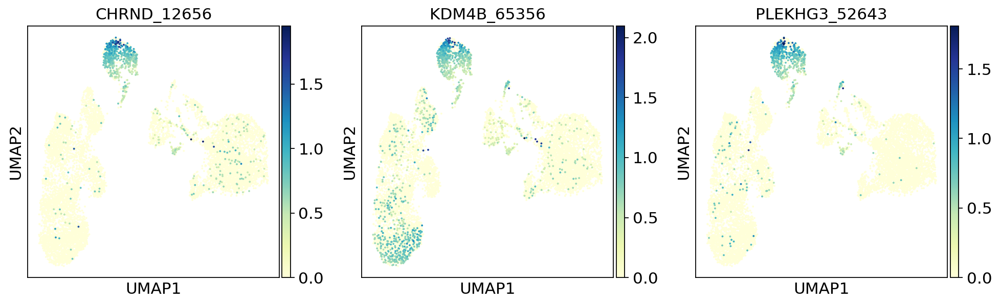

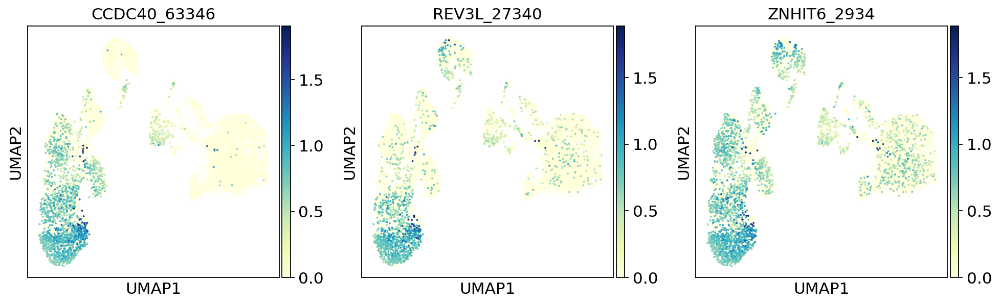

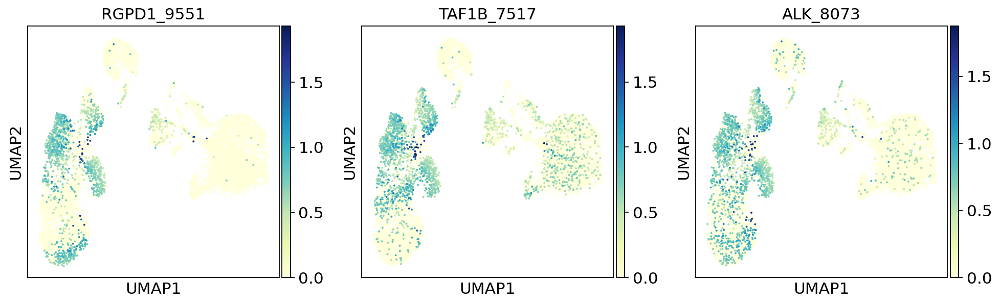

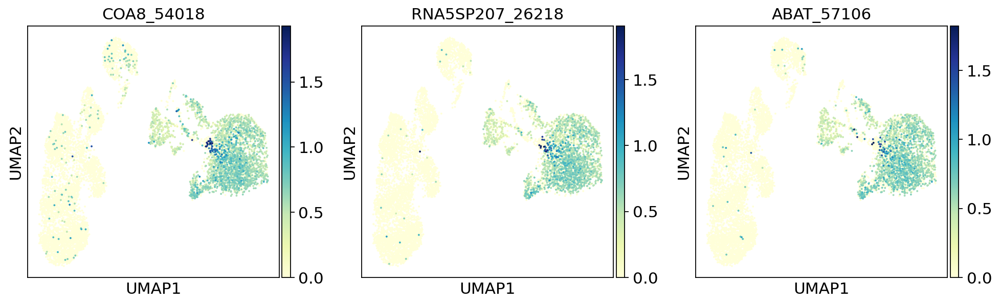

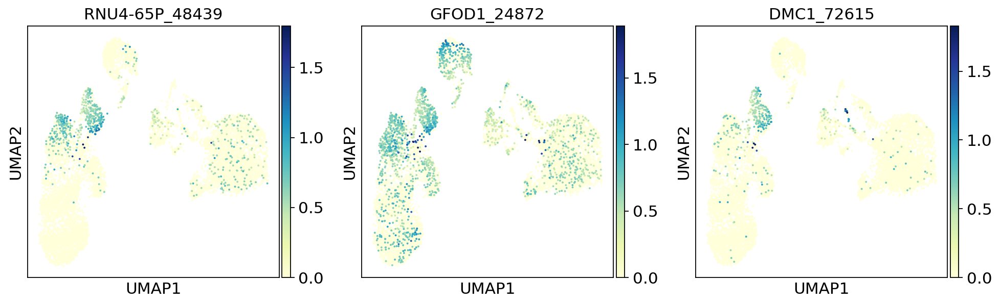

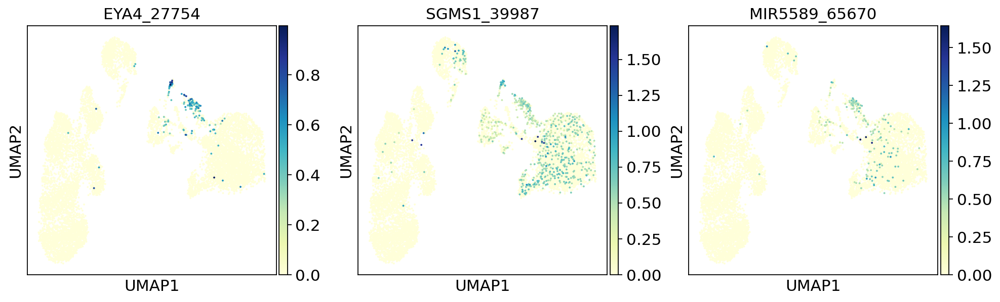

In [60]:
sc.pl.umap(adatax, color=['CHRND_12656', 'KDM4B_65356', 'PLEKHG3_52643'],
           save='Bcells_diff_genes_peak_open.png')
sc.pl.umap(adatax, color=['CCDC40_63346', 'REV3L_27340', 'ZNHIT6_2934'],
           save='CD4+_T_cells_diff_genes_peak_open.png')
sc.pl.umap(adatax, color=['RGPD1_9551', 'TAF1B_7517', 'ALK_8073'],
           save='CD8+_T_cells_diff_genes_peak_open.png')
sc.pl.umap(adatax, color=['COA8_54018', 'RNA5SP207_26218', 'ABAT_57106'],
           save='Myeloidcells_diff_genes_peak_open.png')

sc.pl.umap(adatax, color=['RNU4-65P_48439', 'GFOD1_24872', 'DMC1_72615'],
           save='NKcells_diff_genes_peak_open.png')

sc.pl.umap(adatax, color=['EYA4_27754', 'SGMS1_39987', 'MIR5589_65670'],
           save='Progenitors_diff_genes_peak_open.png')
           

FCGR2C_4870


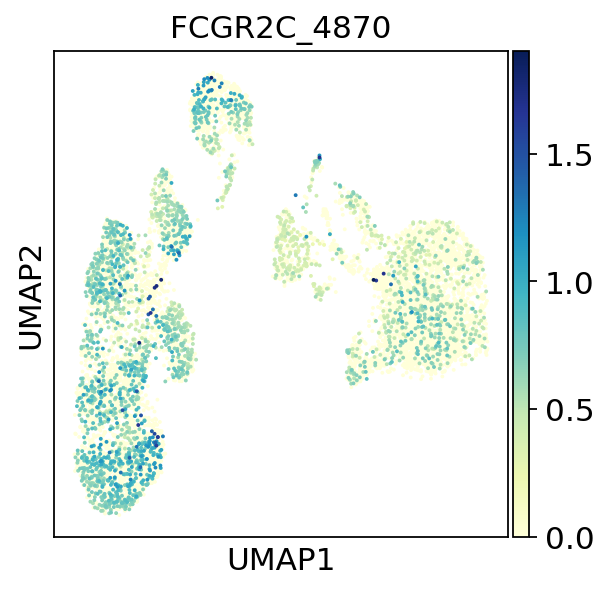

FCGR2C_4871


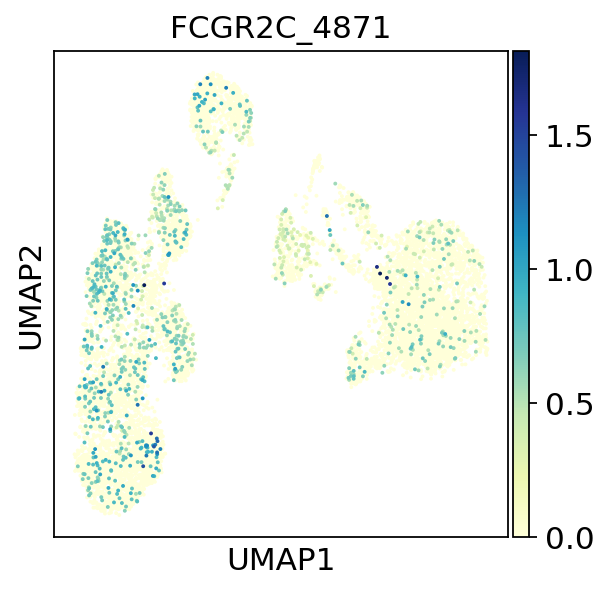

FCGR2C_4872


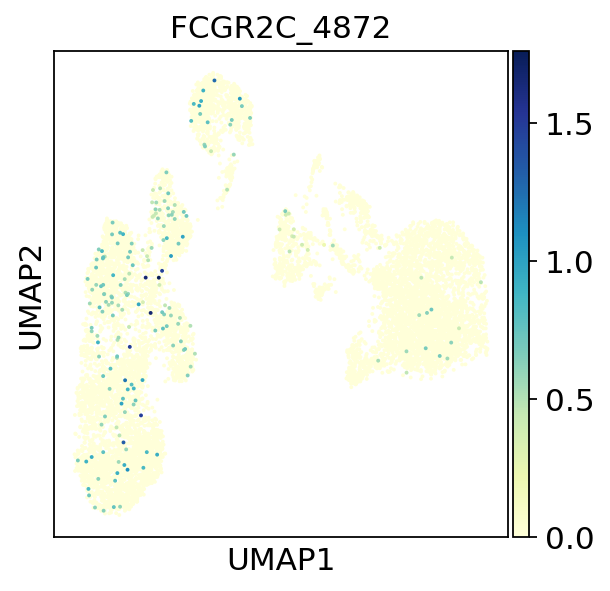

FCGR2C_4873


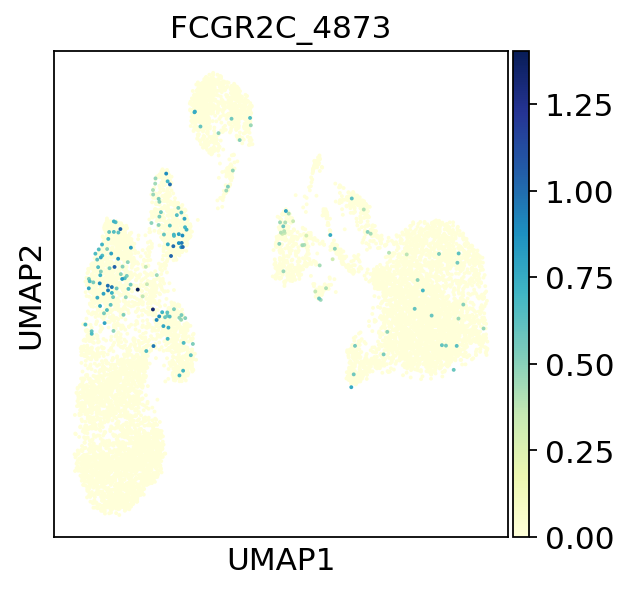

SPON2_17824


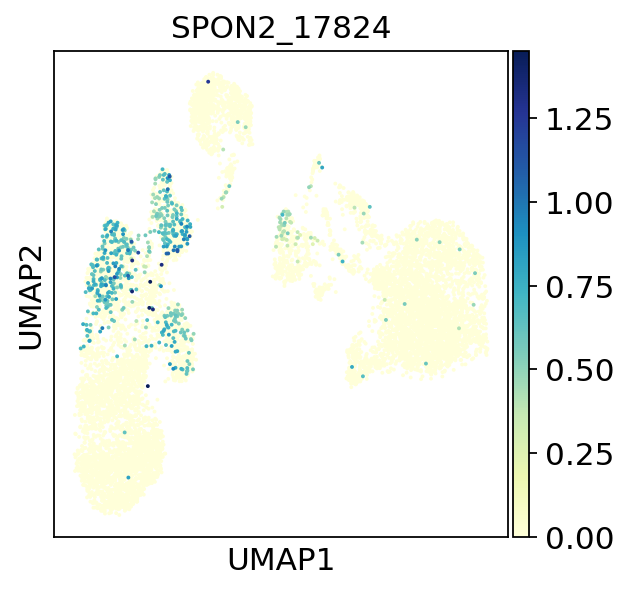

SPON2_17825


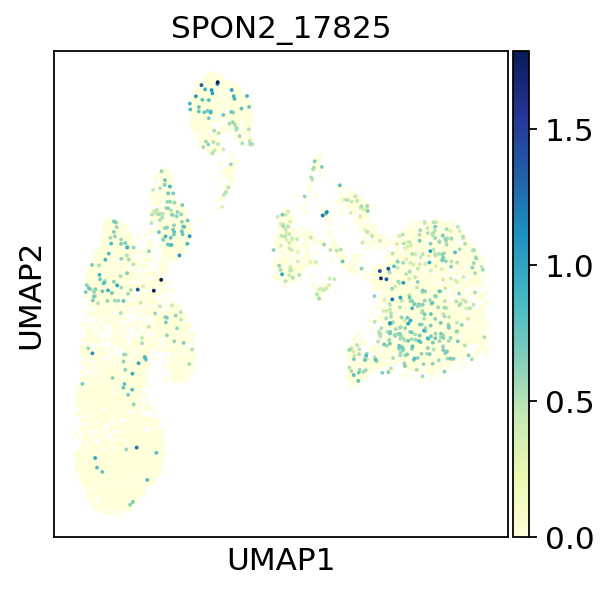

SPON2_17826


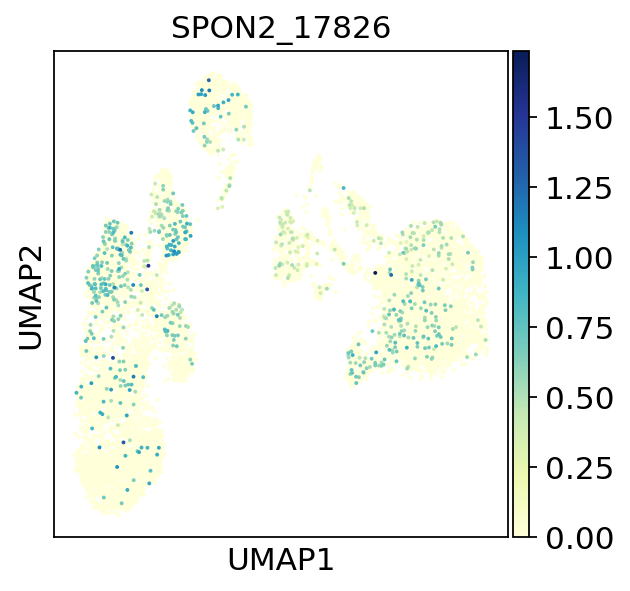

SPON2_17827


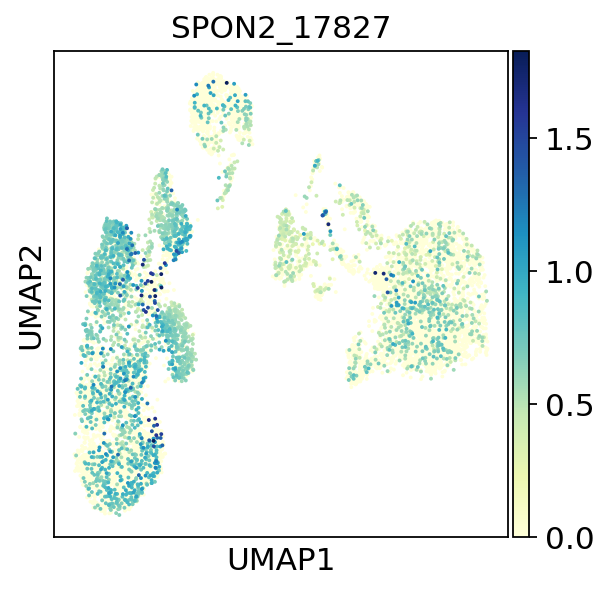

SPON2_17828


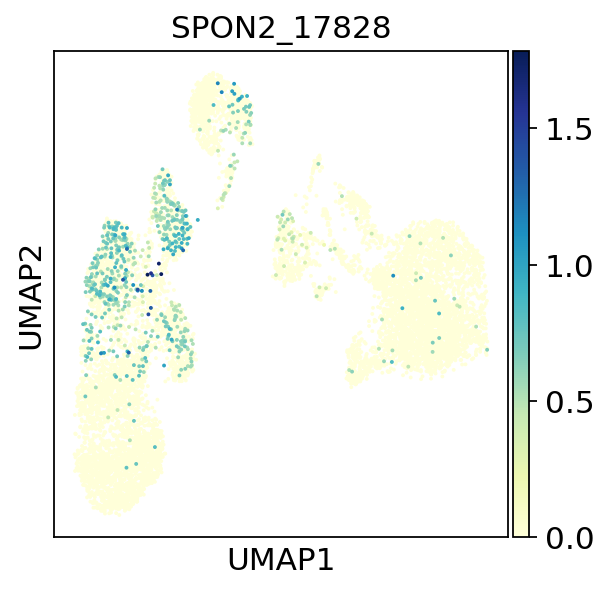

SPON2_17829


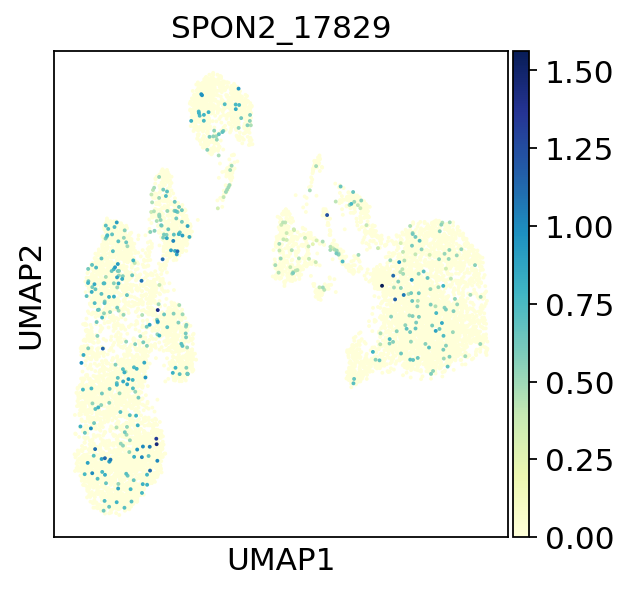

SPON2_17830


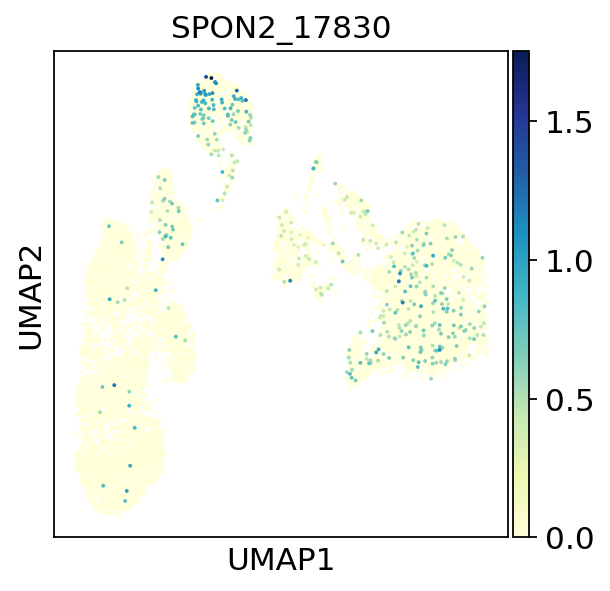

RHOH_18611


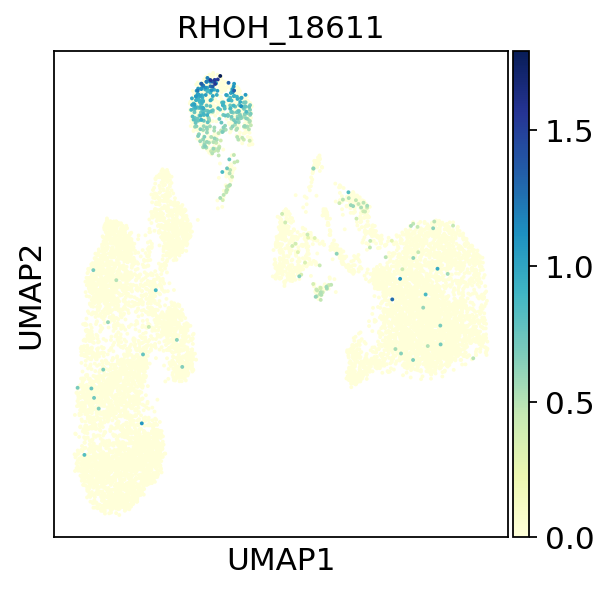

RHOH_18612


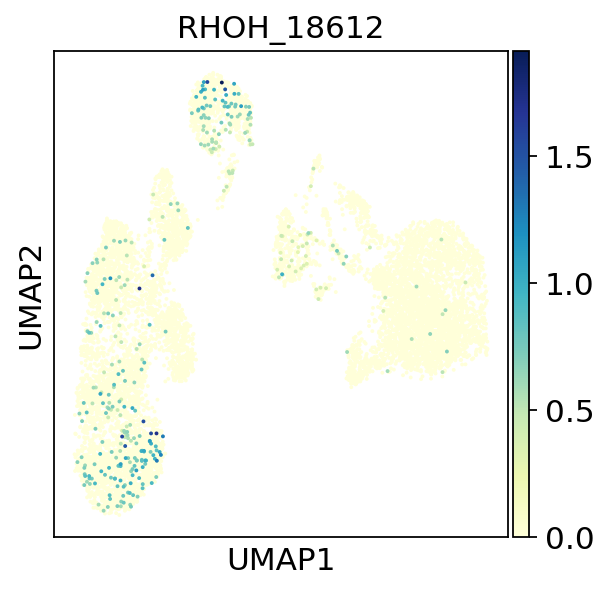

RHOH_18613


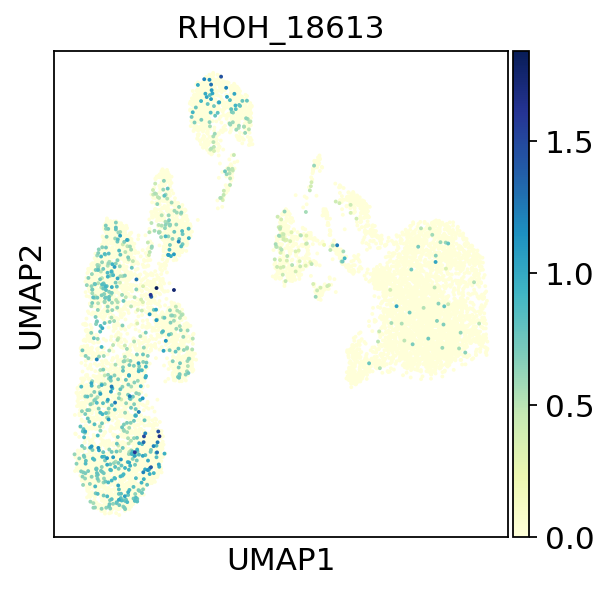

RHOH_18614


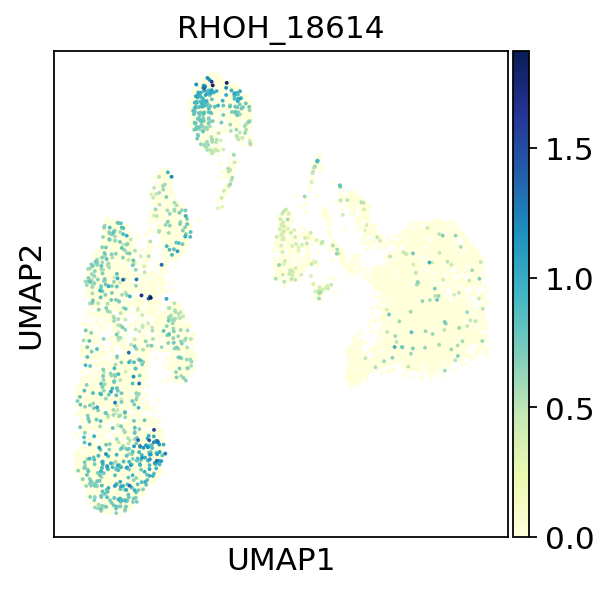

RHOH_18615


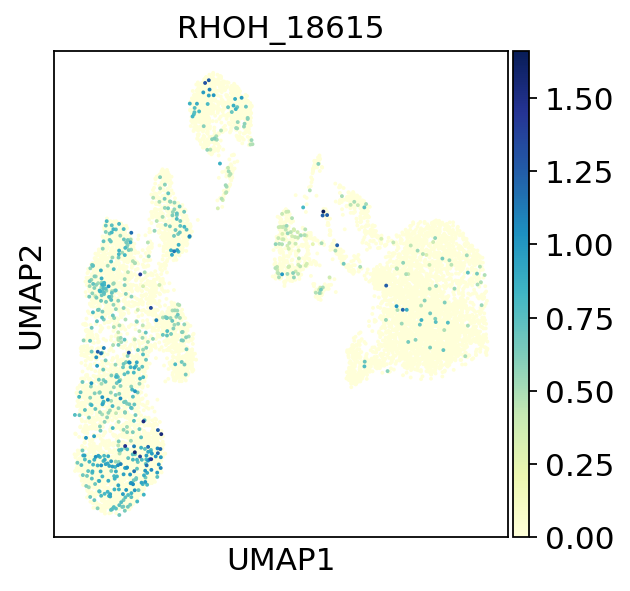

RHOH_18616


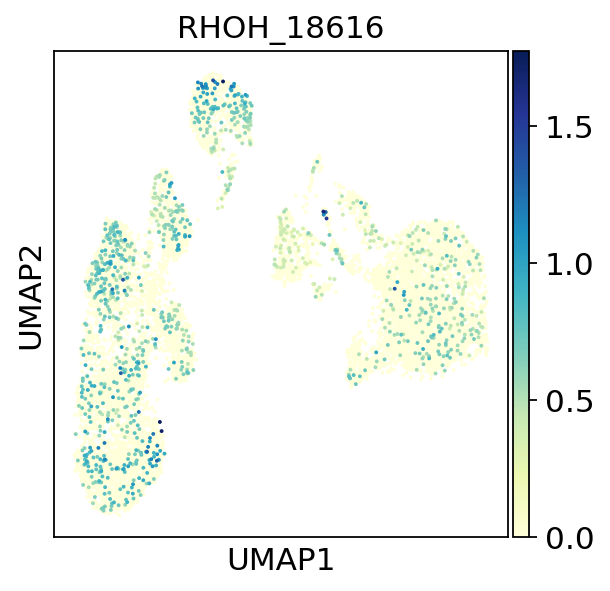

RHOH_18617


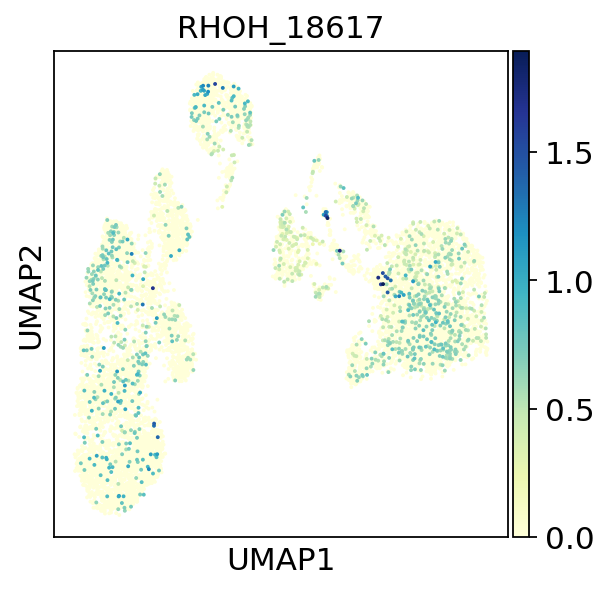

RHOH_18618


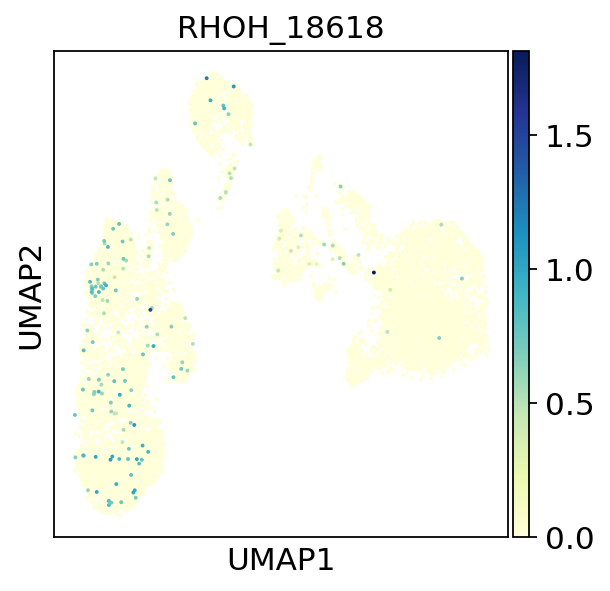

RHOH_18619


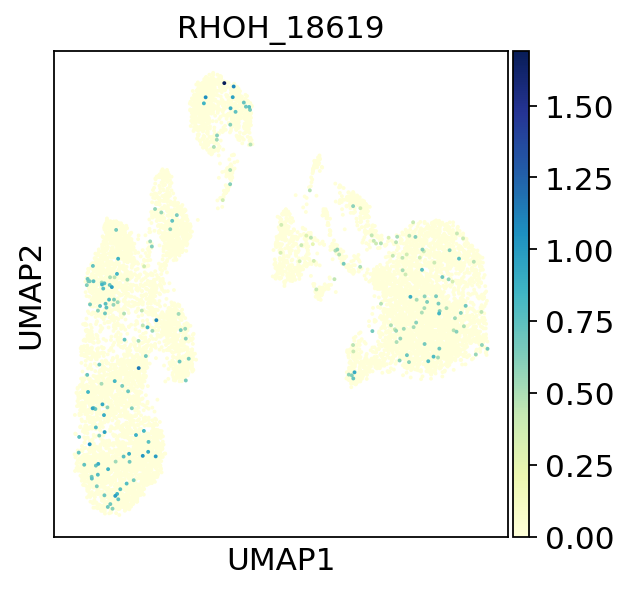

RHOH_18620


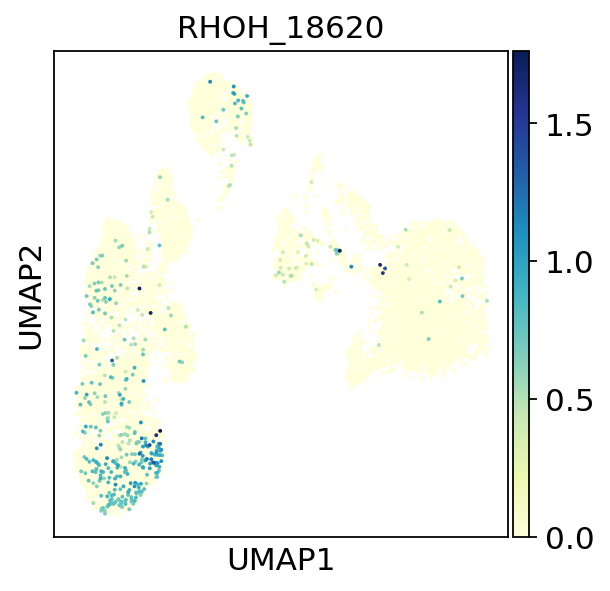

RHOH_18621


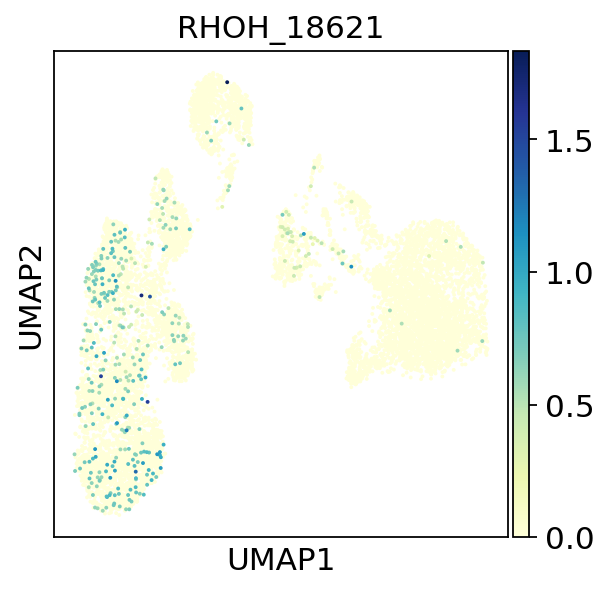

RHOH_18622


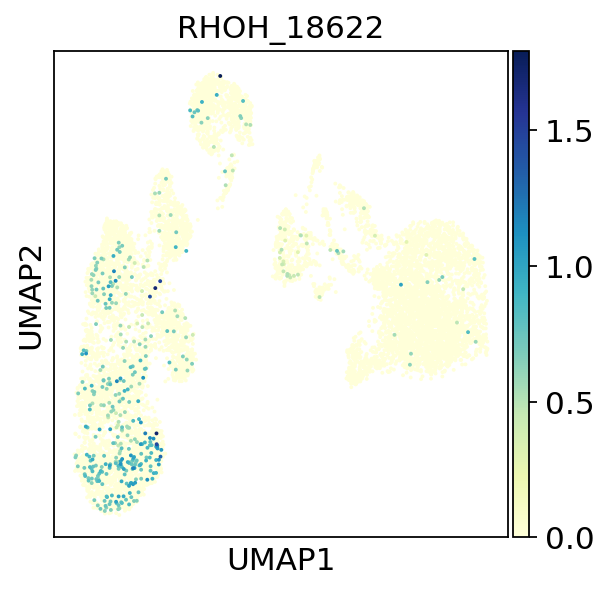

RHOH_18623


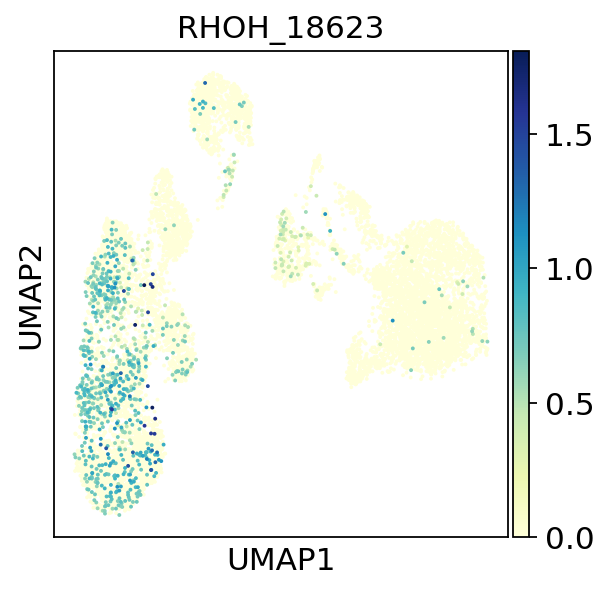

RHOH_18624


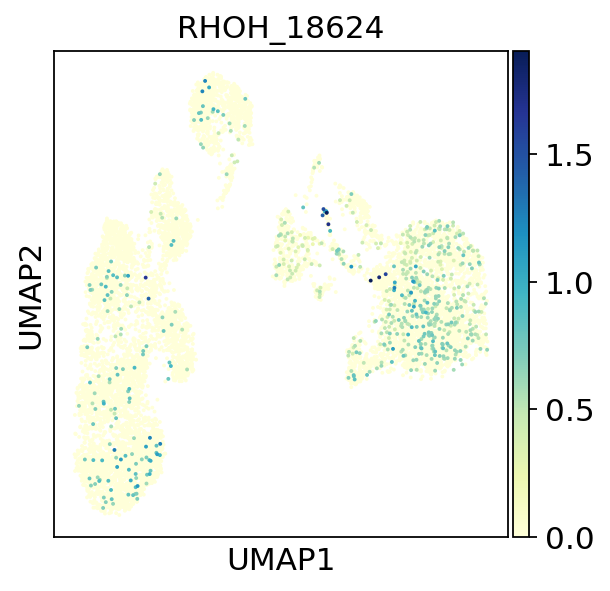

MROH1_35511


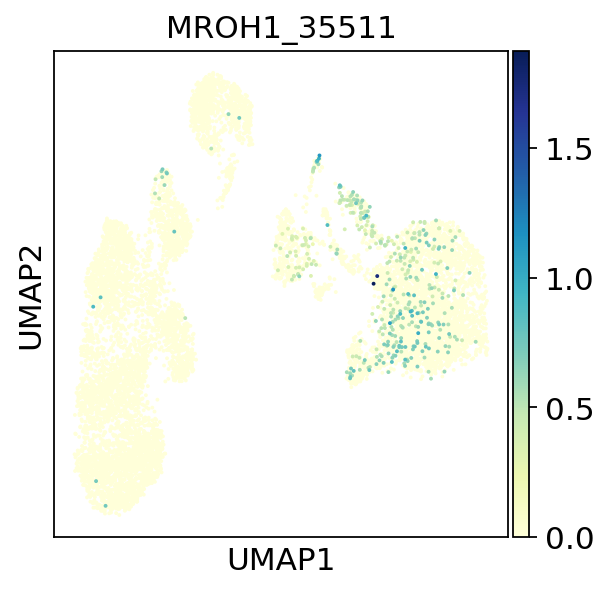

MROH1_35512


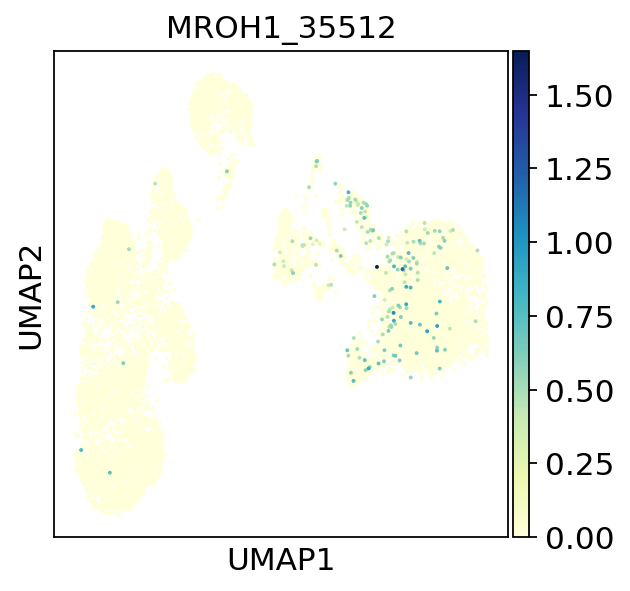

MROH1_35513


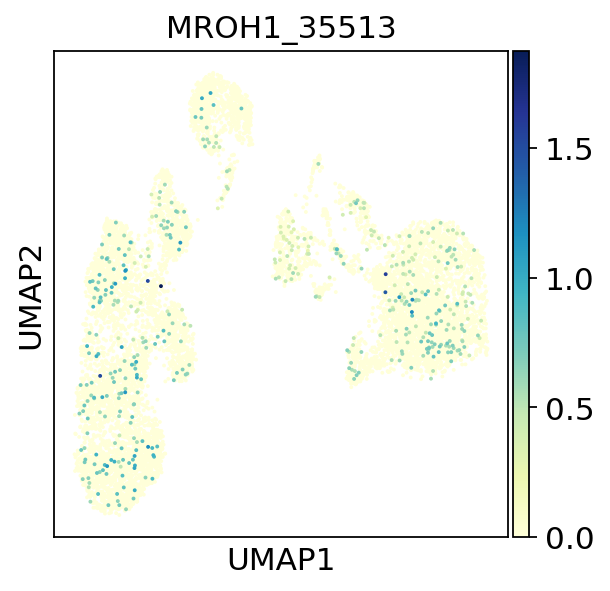

MROH1_35514


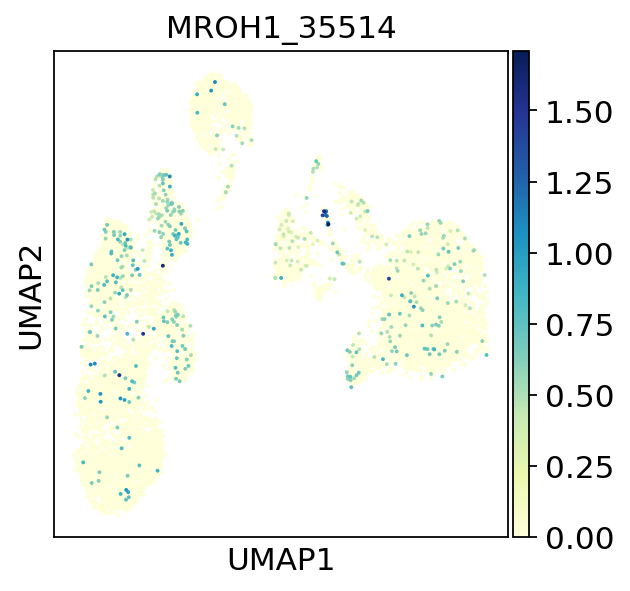

MROH1_35515


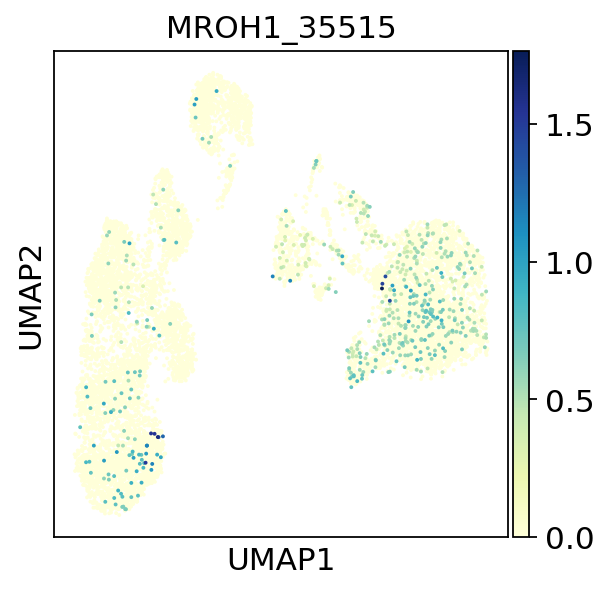

MS4A7_43739


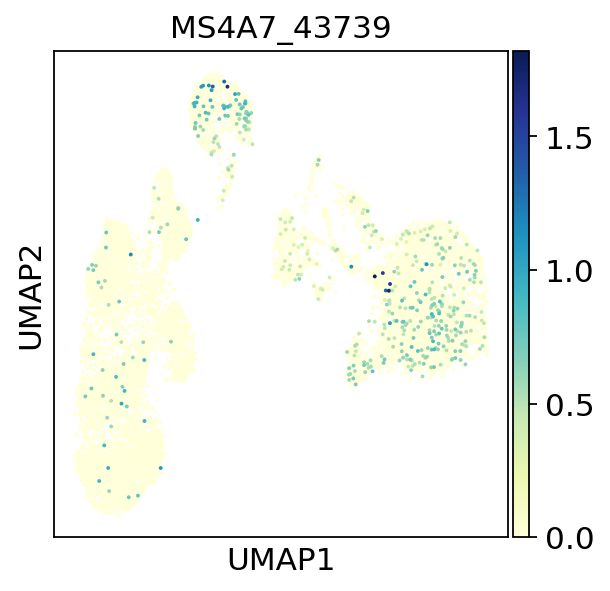

CCDC40_63344


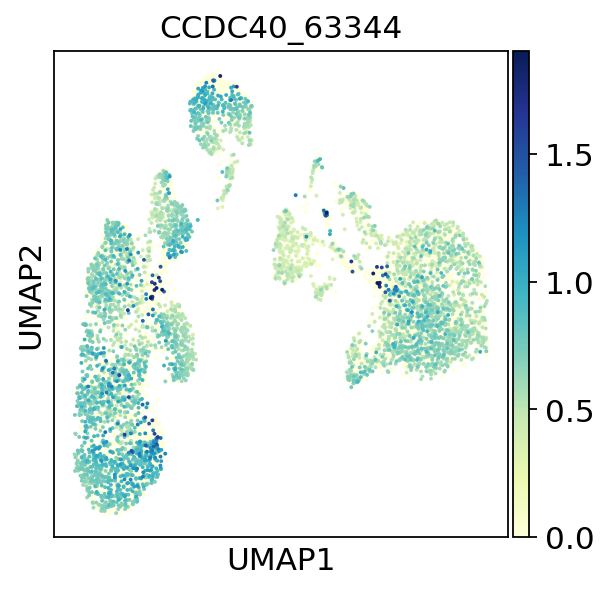

CCDC40_63345


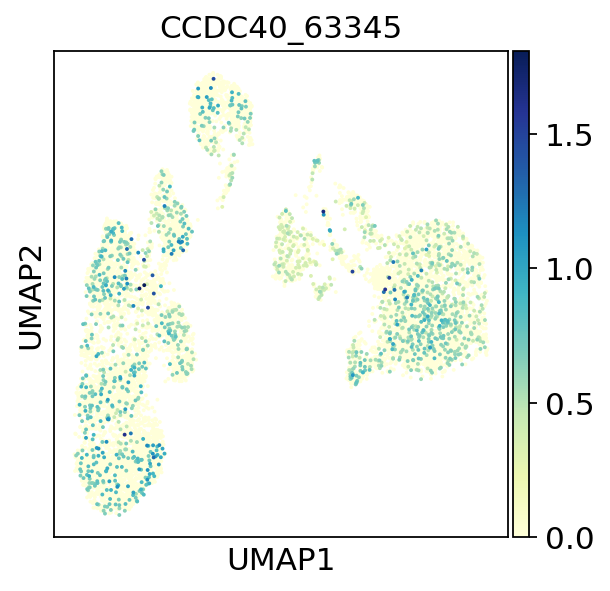

CCDC40_63346


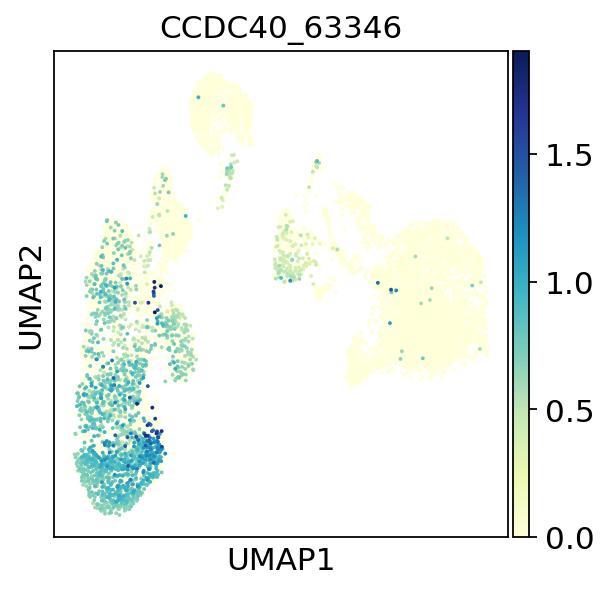

MIR6815;COL18A1_71453


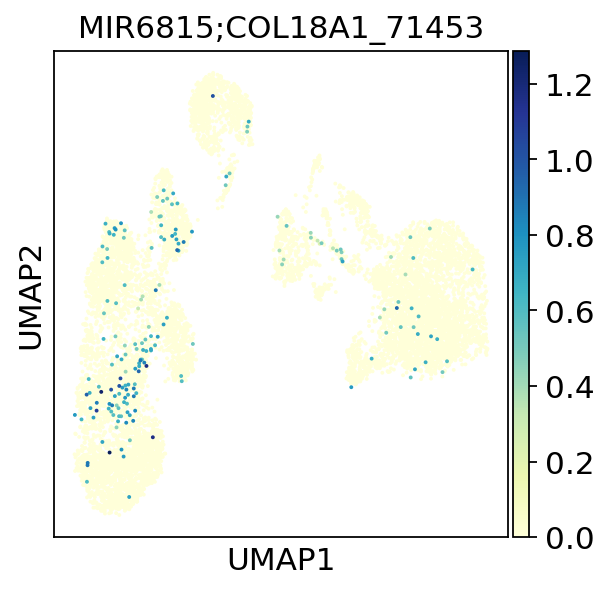

COL18A1_71454


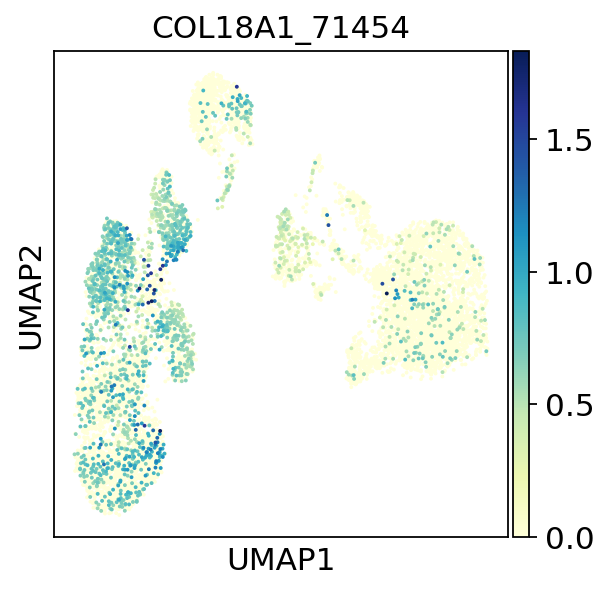

COL18A1_71455


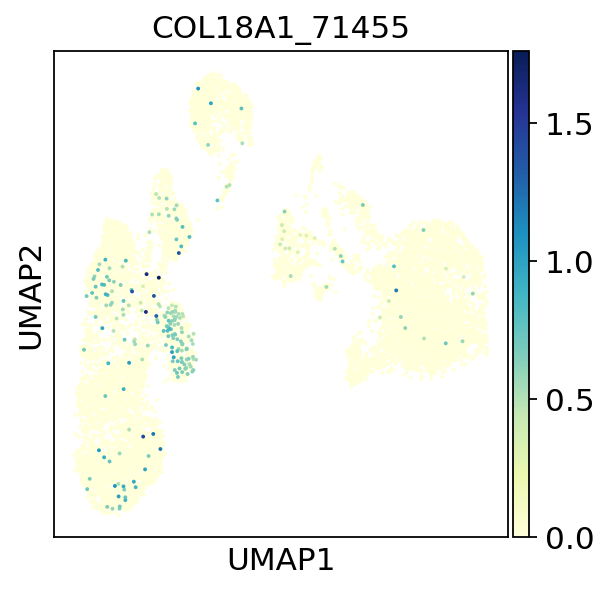

COL18A1_71456


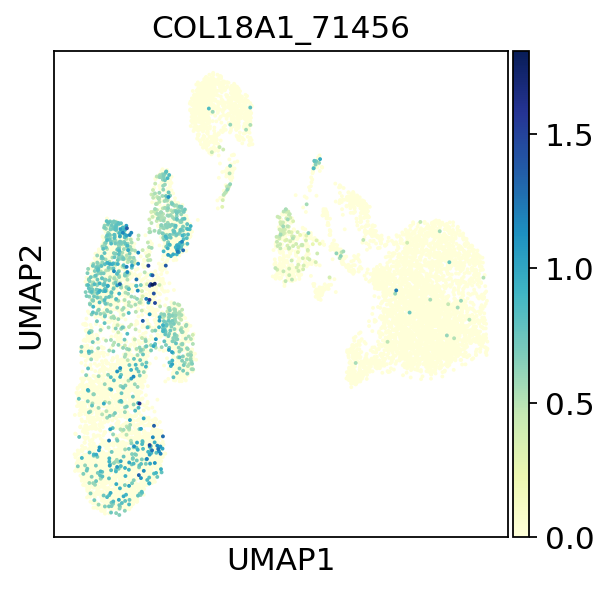

COL18A1_71457


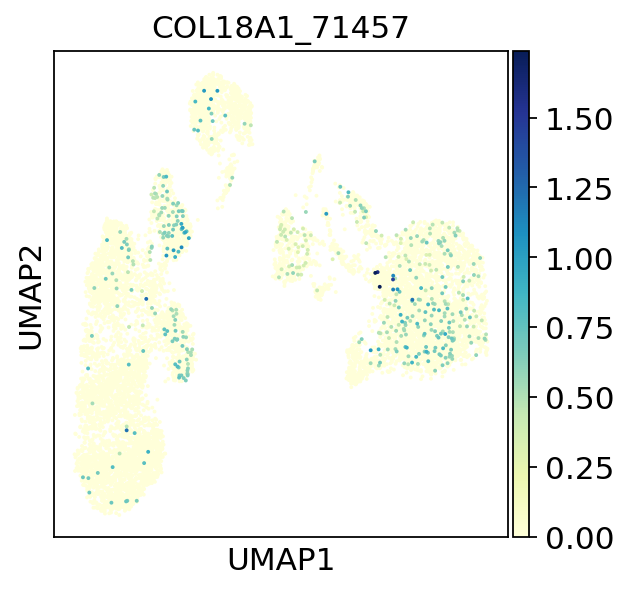

COL18A1_71458


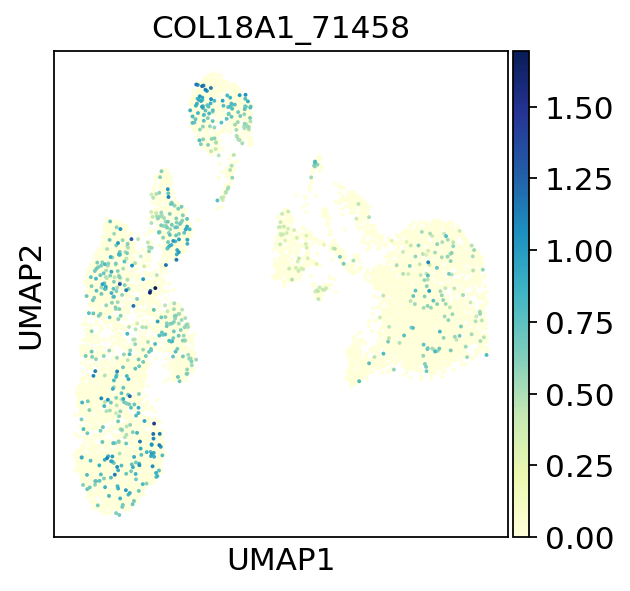

COL18A1_71459


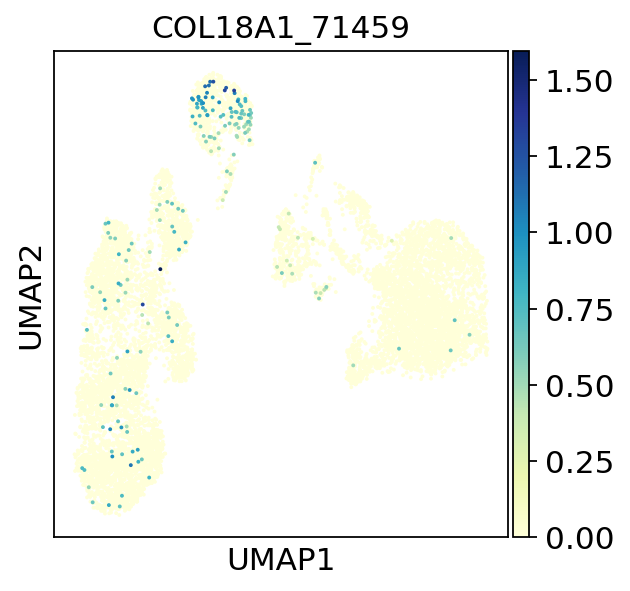

In [61]:
for n in adatax.var_names.tolist():
    if 'SPON2' in n:
        print(n)
        sc.pl.umap(adatax, color=n, save=n+'_peak_open.png')
    elif 'COL18A1' in n:
        print(n)
        sc.pl.umap(adatax, color=n, save=n+'_peak_open.png')
    elif 'CCDC40' in n:
        print(n)
        sc.pl.umap(adatax, color=n, save=n+'_peak_open.png')
    elif 'MS4A7' in n:
        print(n)
        sc.pl.umap(adatax, color=n, save=n+'_peak_open.png')
    elif 'FCGR2C' in n:
        print(n)
        sc.pl.umap(adatax, color=n, save=n+'_peak_open.png')
    elif 'RHOH' in n:
        print(n)
        sc.pl.umap(adatax, color=n, save=n+'_peak_open.png')
    elif 'MROH1' in n:
        print(n)
        sc.pl.umap(adatax, color=n, save=n+'_peak_open.png')

... storing 'gene_id' as categorical
... storing 'gene_type' as categorical
... storing 'gene_name' as categorical
... storing 'transcript_type' as categorical
... storing 'protein_id' as categorical


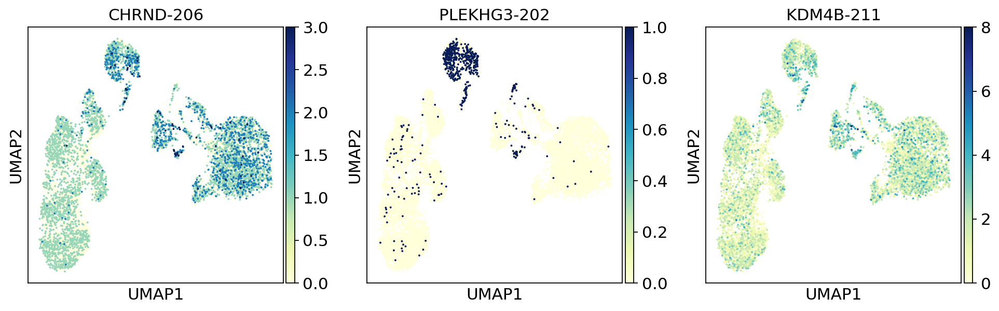

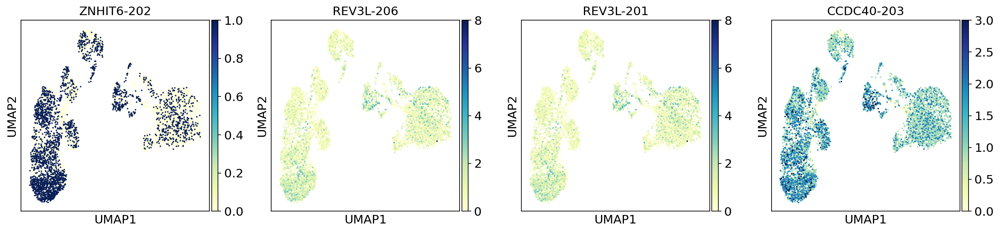

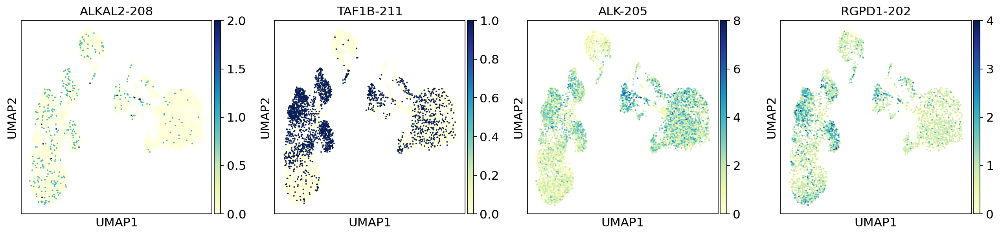

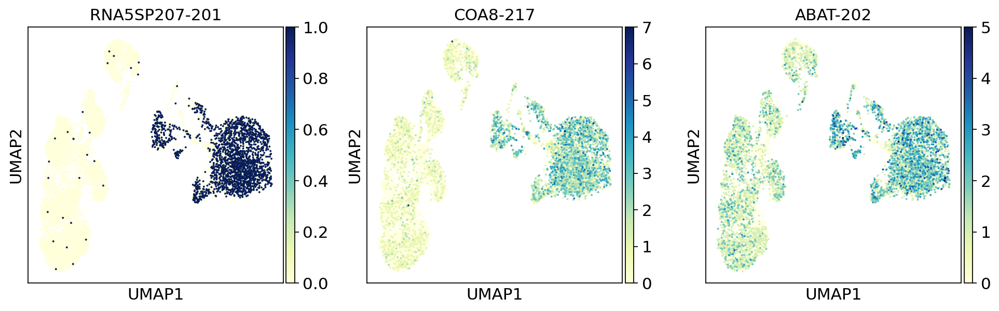

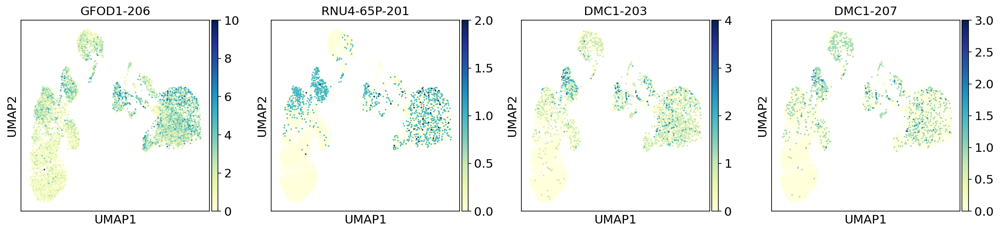

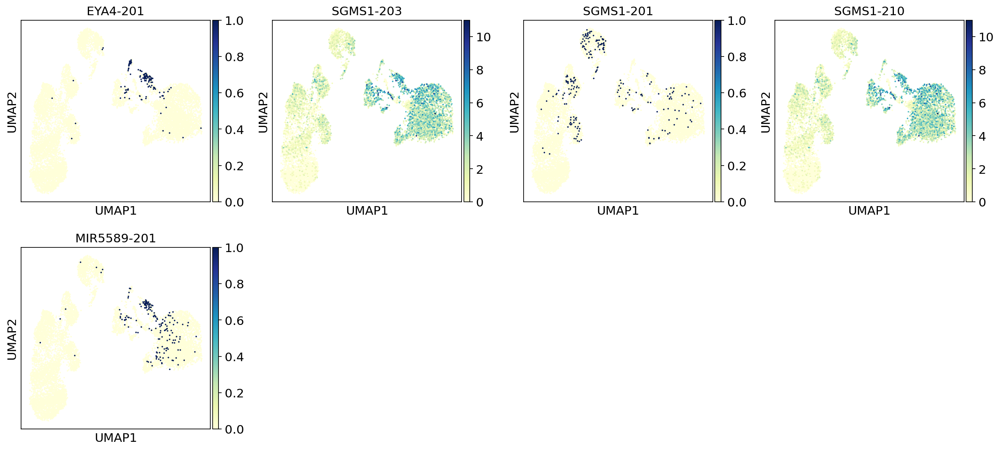

In [68]:
color = []
for n in adatag.var_names:
    if 'CHRND' in n:
        color.append(n)
    elif 'KDM4B' in n:
        color.append(n)
    elif 'PLEKHG3' in n:
        color.append(n)
sc.pl.umap(adatag, color=color,
           save='Bcells_diff_genes_gene_activity.png')

color = []
for n in adatag.var_names:
    if 'CCDC40' in n:
        color.append(n)
    elif 'REV3L' in n:
        color.append(n)
    elif 'ZNHIT6' in n:
        color.append(n)
sc.pl.umap(adatag, color=color,
           save='CD4+_T_cells_diff_genes_gene_activity.png')

color = []
for n in adatag.var_names:
    if 'RGPD1' in n:
        color.append(n)
    elif 'TAF1B' in n:
        color.append(n)
    elif 'ALK' in n:
        color.append(n)
sc.pl.umap(adatag, color=color,
           save='CD8+_T_cells_diff_genes_gene_activity.png')

color = []
for n in adatag.var_names:
    if 'COA8' in n:
        color.append(n)
    elif 'RNA5SP207' in n:
        color.append(n)
    elif 'ABAT' in n:
        color.append(n)
sc.pl.umap(adatag, color=color,
           save='Myeloid_cells_diff_genes_gene_activity.png')

color = []
for n in adatag.var_names:
    if 'RNU4-65P' in n:
        color.append(n)
    elif 'GFOD1' in n:
        color.append(n)
    elif 'DMC1' in n:
        color.append(n)
sc.pl.umap(adatag, color=color,
           save='NK_cells_diff_genes_gene_activity.png')

color = []
for n in adatag.var_names:
    if 'EYA4' in n:
        color.append(n)
    elif 'SGMS1' in n:
        color.append(n)
    elif 'MIR5589' in n:
        color.append(n)
sc.pl.umap(adatag, color=color,
           save='Progenitors_diff_genes_gene_activity.png')
           

In [67]:
adatag

AnnData object with n_obs × n_vars = 9891 × 5812
    obs: 'nb_features', 'log_nb_features', 'n_counts', 'louvain', '10x_cell_type_annot'
    var: 'gene_id', 'transcript_id', 'gene_type', 'gene_name', 'transcript_type', 'transcript_name', 'protein_id'
    uns: '10x_cell_type_annot_colors', 'broad_annot_colors', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    obsp: 'connectivities', 'distances'

FCGR2C-211


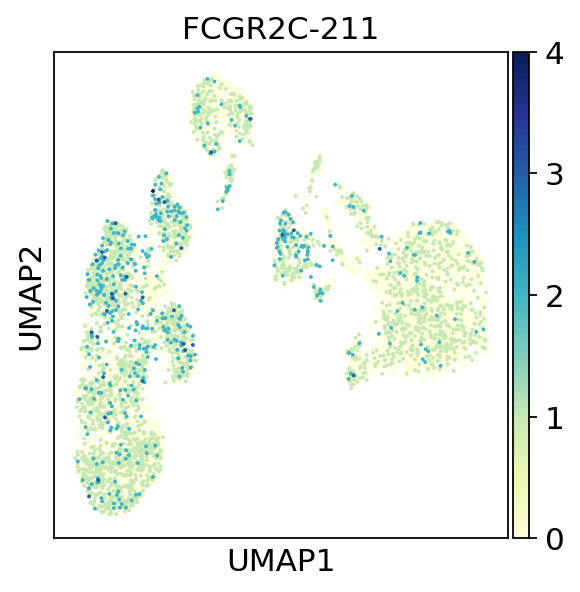

FCGR2C-212


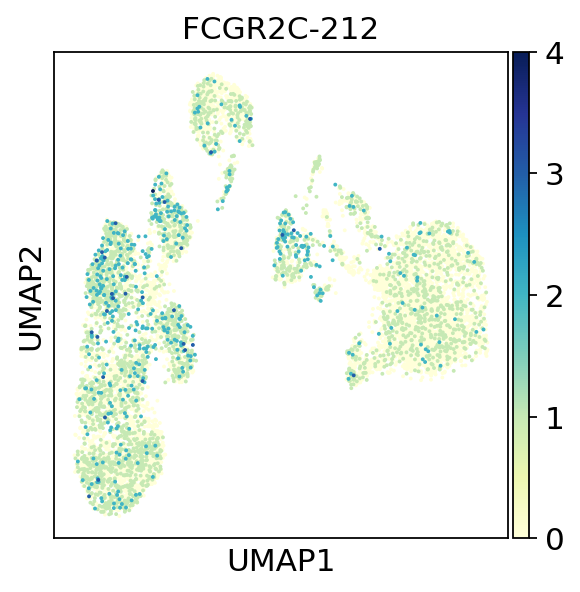

SPON2-203


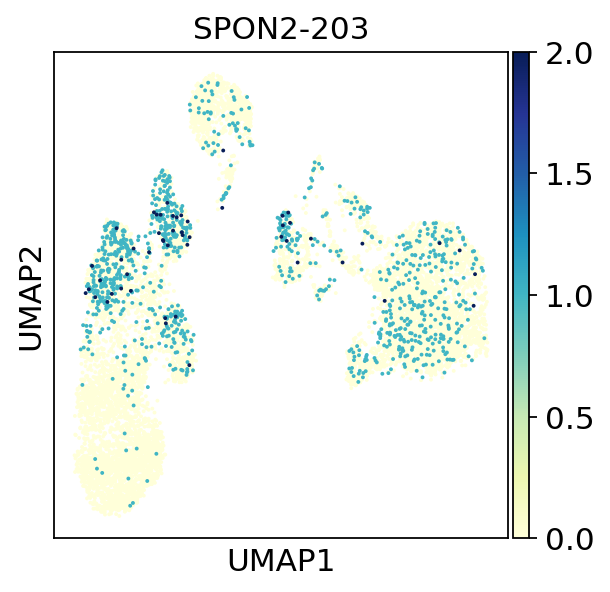

SPON2-222


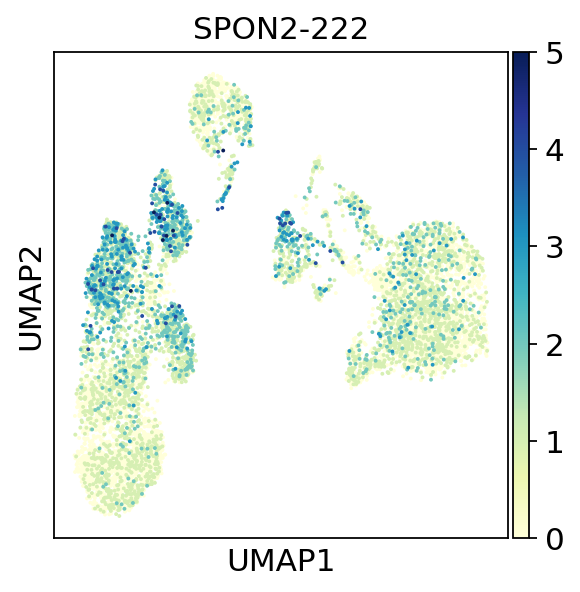

RHOH-221


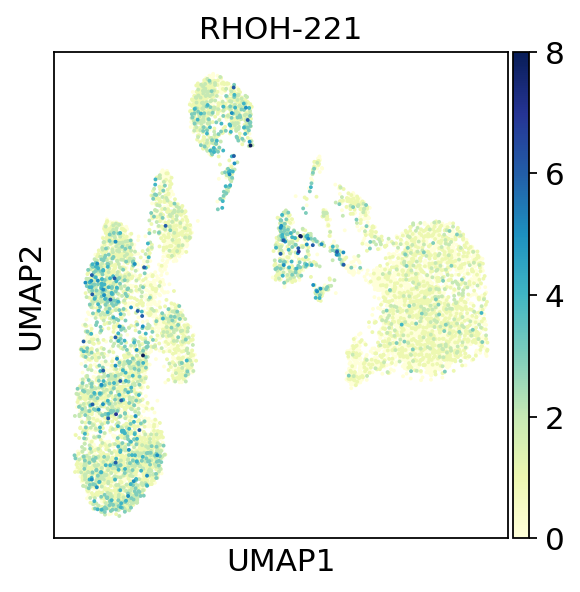

RHOH-218


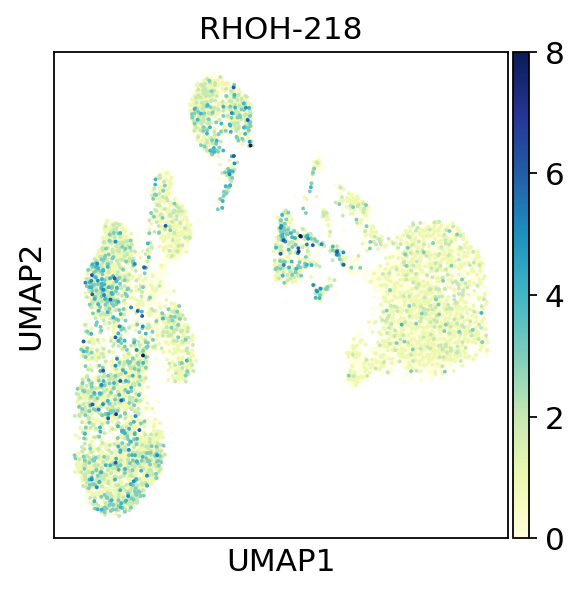

RHOH-222


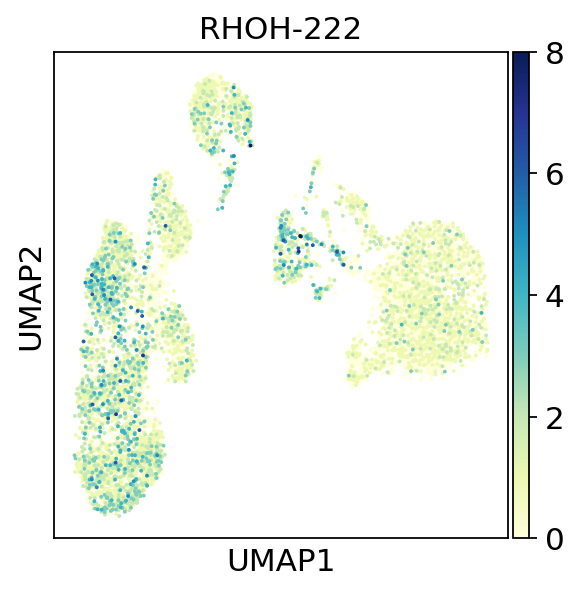

RHOH-224


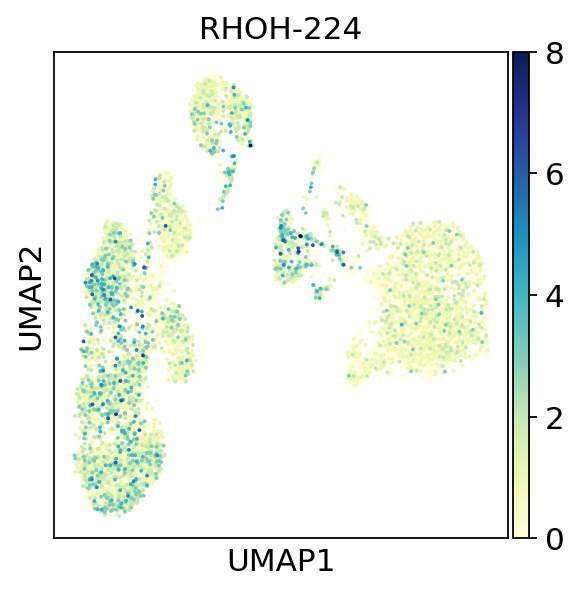

RHOH-223


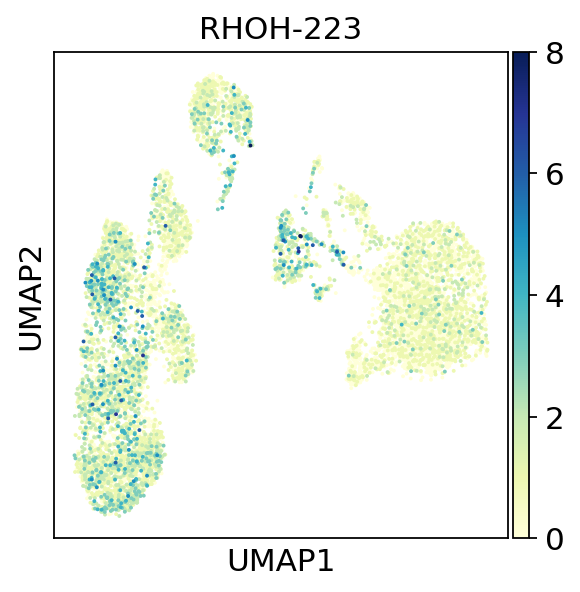

RHOH-220


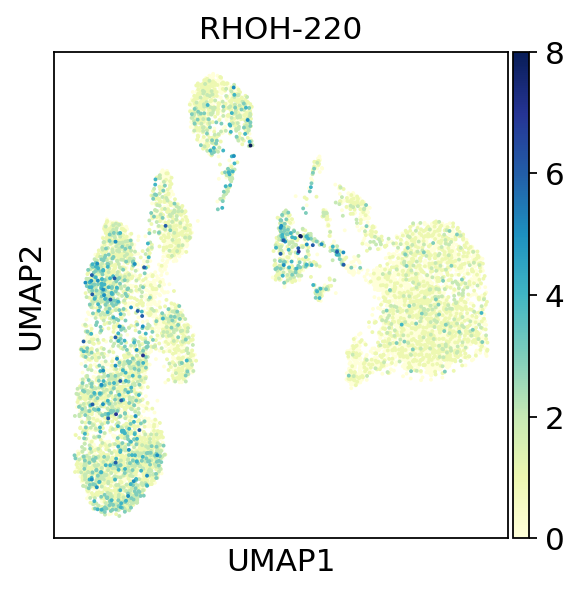

RHOH-217


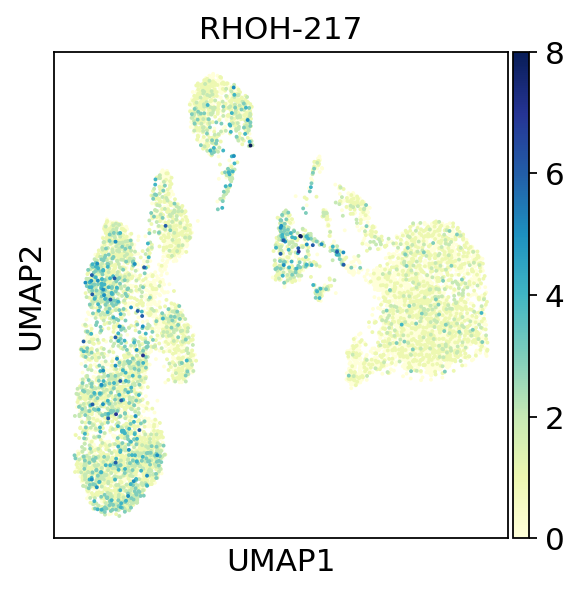

RHOH-219


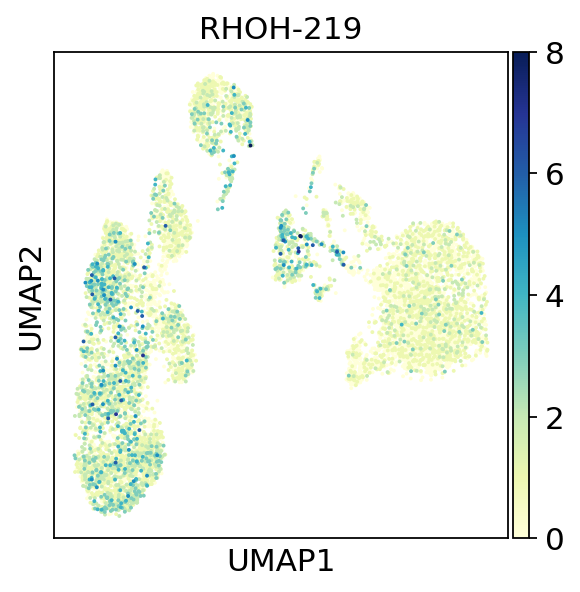

MROH1-201


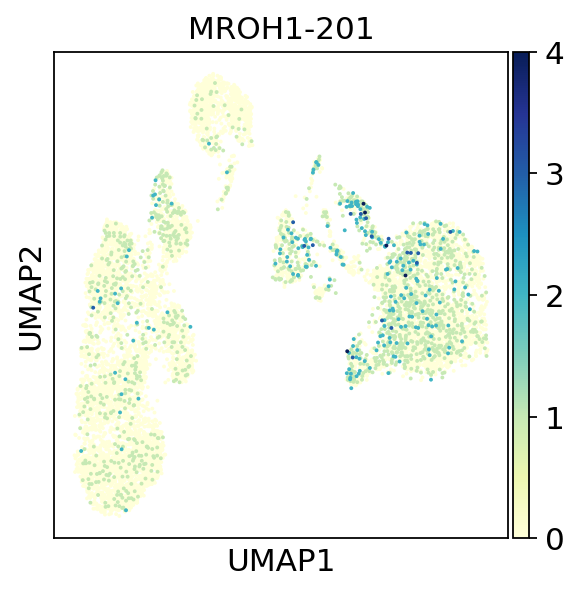

MROH1-211


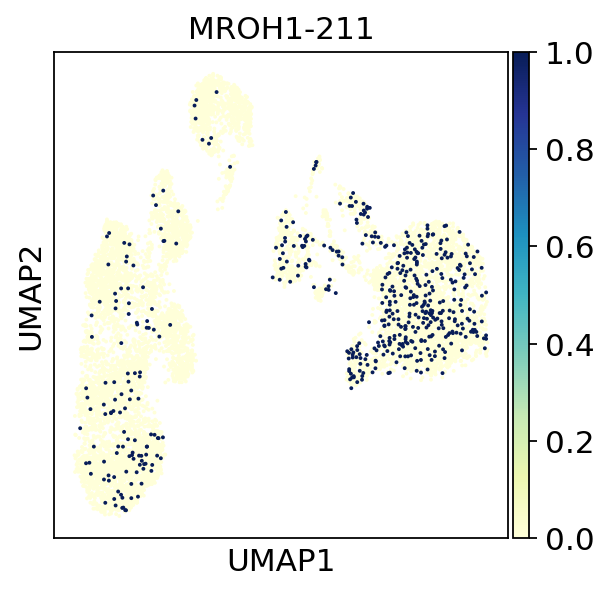

MS4A7-202


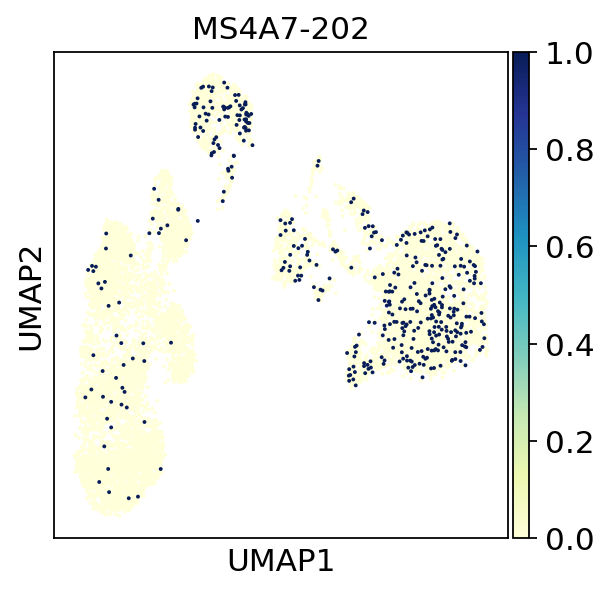

CCDC40-203


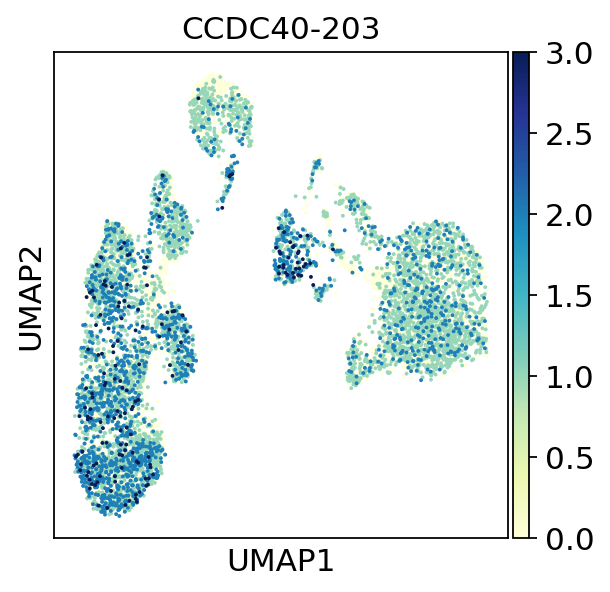

COL18A1-203


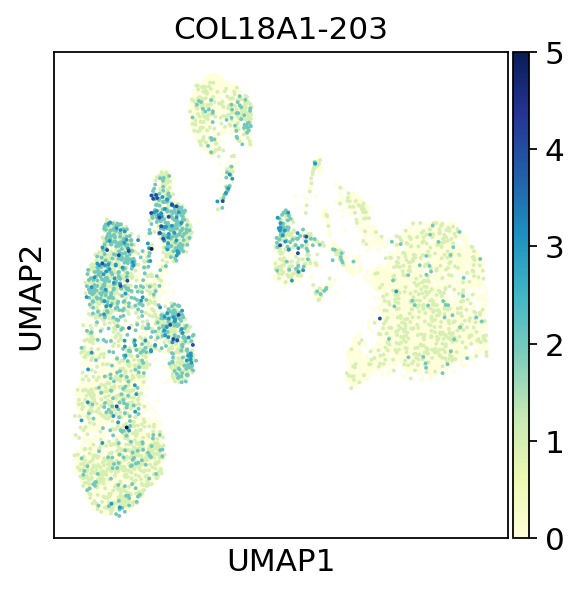

In [69]:
for n in adatag.var_names.tolist():
    if 'SPON2' in n:
        print(n)
        sc.pl.umap(adatag, color=n, save=n+'_gene_activity.png')
    elif 'COL18A1' in n:
        print(n)
        sc.pl.umap(adatag, color=n, save=n+'_gene_activity.png')
    elif 'CCDC40' in n:
        print(n)
        sc.pl.umap(adatag, color=n, save=n+'_gene_activity.png')
    elif 'MS4A7' in n:
        print(n)
        sc.pl.umap(adatag, color=n, save=n+'_gene_activity.png')
    elif 'FCGR2C' in n:
        print(n)
        sc.pl.umap(adatag, color=n, save=n+'_gene_activity.png')
    elif 'RHOH' in n:
        print(n)
        sc.pl.umap(adatag, color=n, save=n+'_gene_activity.png')
    elif 'MROH1' in n:
        print(n)
        sc.pl.umap(adatag, color=n, save=n+'_gene_activity.png')

In [64]:
adatag.var_names

Index(['RNU6-1199P', 'MIR200B', 'MIR200A', 'MIR429', 'MIR6808', 'RN7SL657P',
       'RNU6-731P', 'MIR34A', 'RN7SKP269', 'RN7SL731P',
       ...
       'MIR384', 'RNU6-345P', 'RNU1-67P', 'RNU6-122P', 'AL807743.1',
       'RN7SL687P', 'MIR3202-1', 'MIR718', 'MIR6858', 'RNU6-1334P'],
      dtype='object', length=1352)

In [76]:
adatag

AnnData object with n_obs × n_vars = 9891 × 5812
    obs: 'nb_features', 'log_nb_features', 'n_counts', 'louvain', '10x_cell_type_annot'
    var: 'gene_id', 'transcript_id', 'gene_type', 'gene_name', 'transcript_type', 'transcript_name', 'protein_id'
    uns: '10x_cell_type_annot_colors', 'broad_annot_colors', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    obsp: 'connectivities', 'distances'

In [77]:
sc.tl.rank_genes_groups(adatag, "10x_cell_type_annot", use_raw=False)

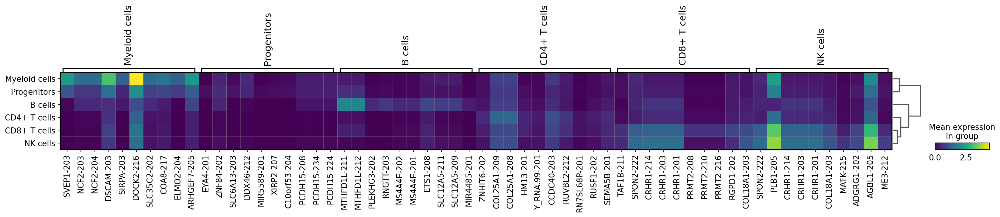

In [78]:
sc.pl.rank_genes_groups_matrixplot(adatag)

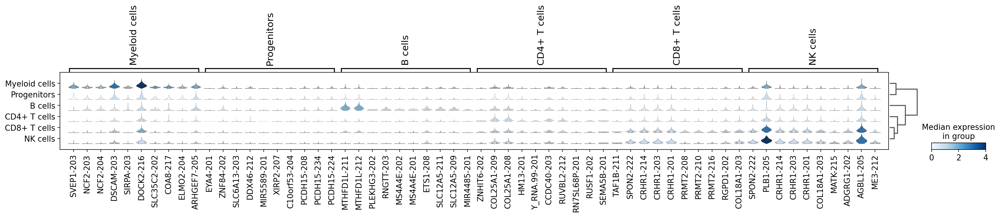

In [79]:
sc.pl.rank_genes_groups_stacked_violin(adatag)

In [80]:
sc.pp.normalize_per_cell(adatag)
sc.pp.log1p(adatag)

In [81]:
sc.tl.rank_genes_groups(adatag, "10x_cell_type_annot", use_raw=False)

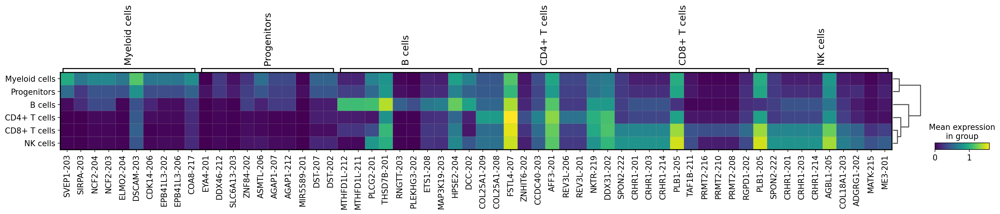

In [82]:
sc.pl.rank_genes_groups_matrixplot(adatag)

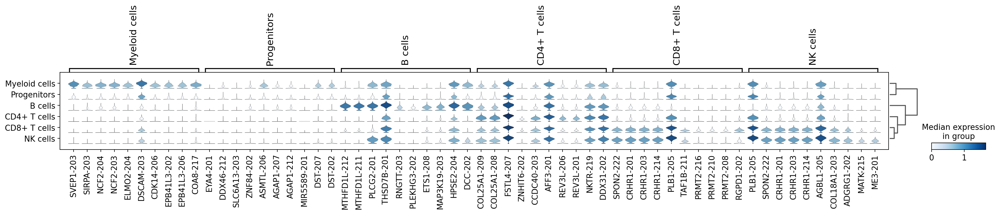

In [84]:
sc.pl.rank_genes_groups_stacked_violin(adatag, save='gene_activity_10x.png')

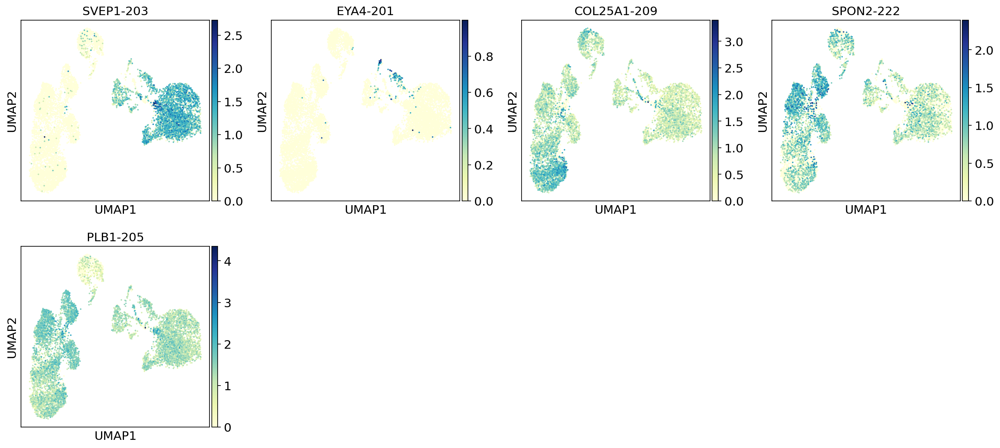

In [86]:
sc.pl.umap(adatag, color=['SVEP1-203',
                          'EYA4-201',
                         'COL25A1-209',
                          'SPON2-222',
                          'PLB1-205'],
          save='gene_activity_10x_top_diff_genes.png')

PLB1_8021


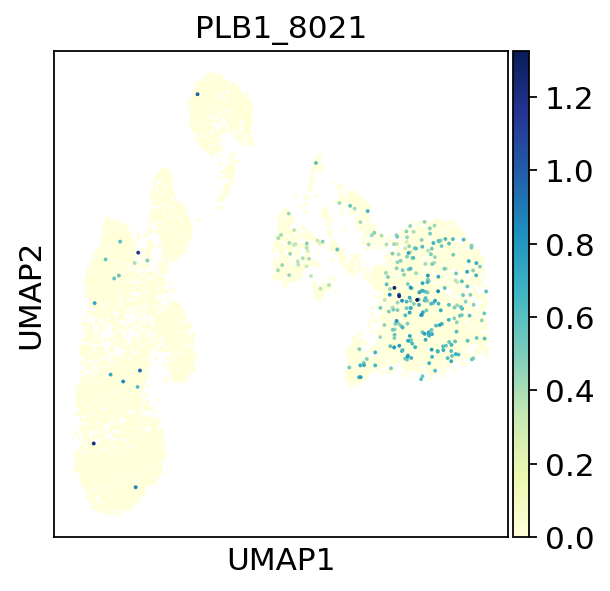

PLB1_8022


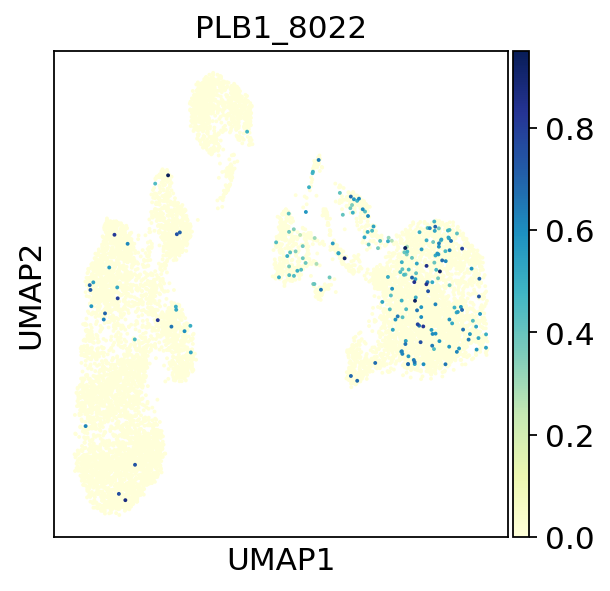

PLB1_8023


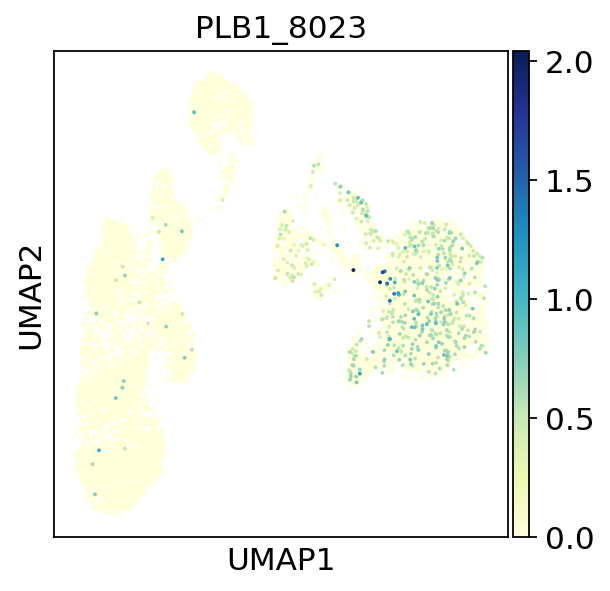

PLB1_8024


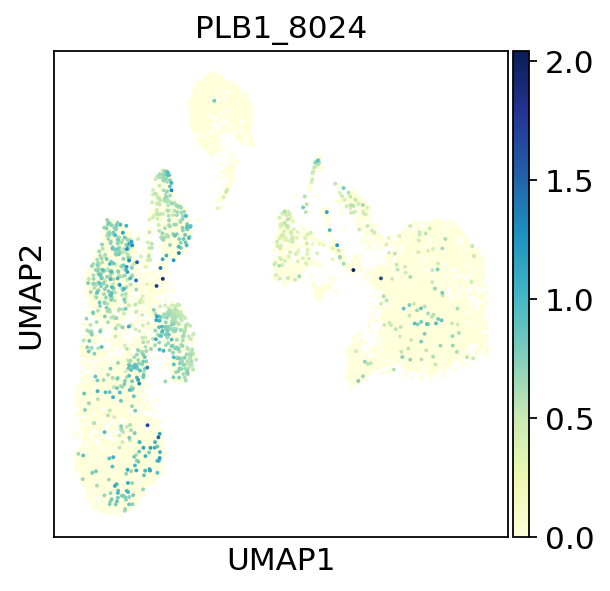

PLB1_8025


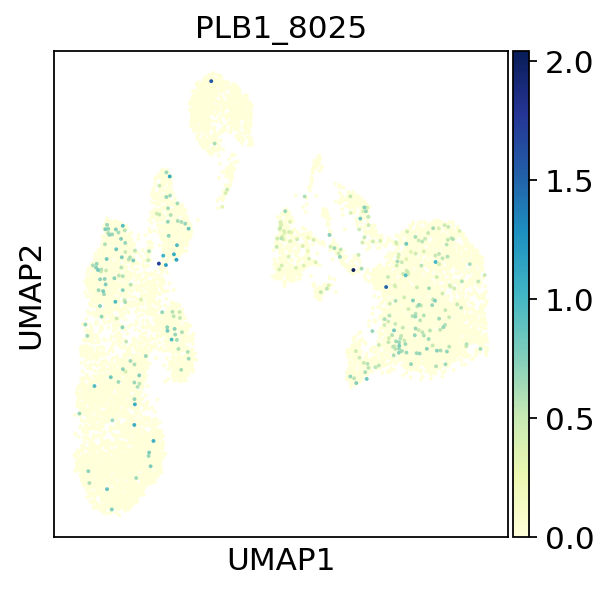

PLB1_8026


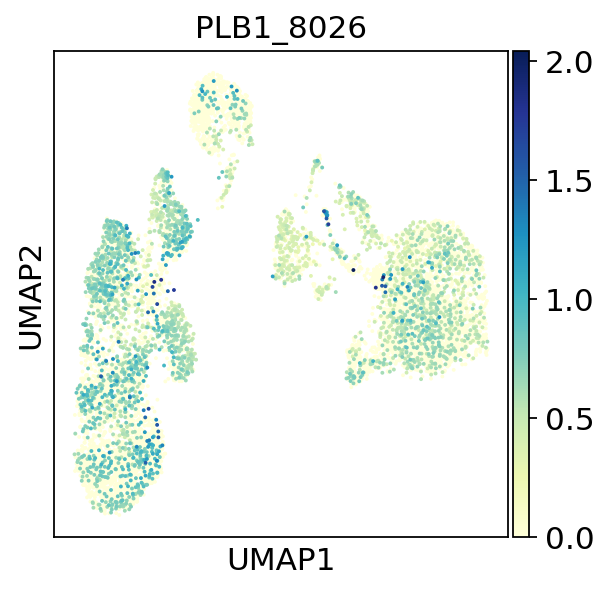

PLB1_8027


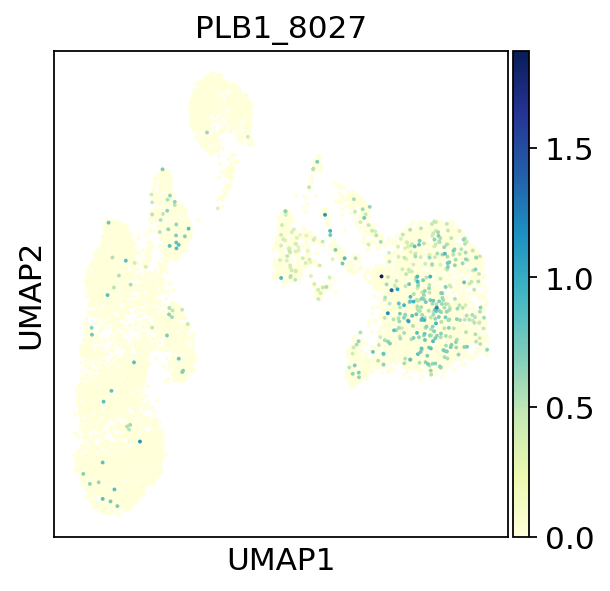

PLB1_8028


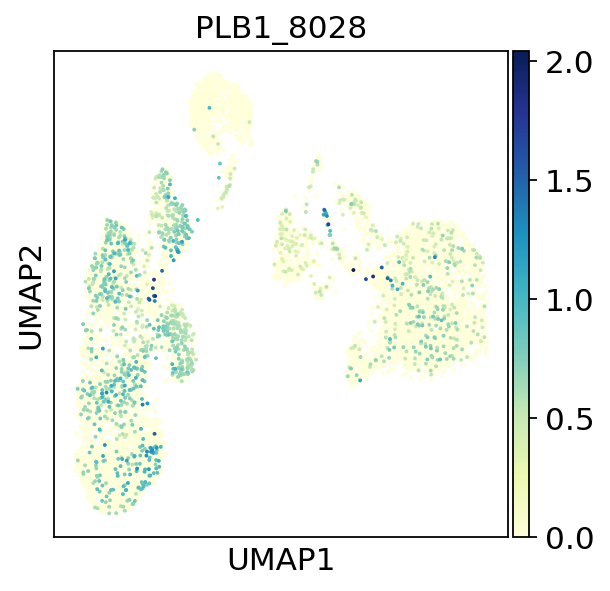

PLB1_8029


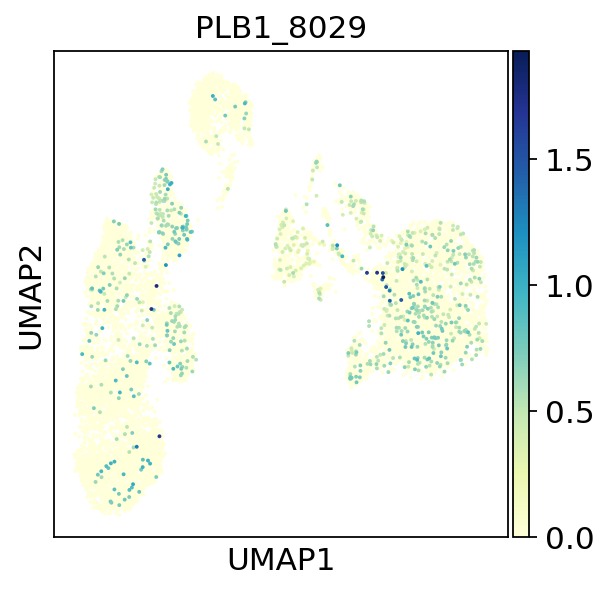

PLB1_8030


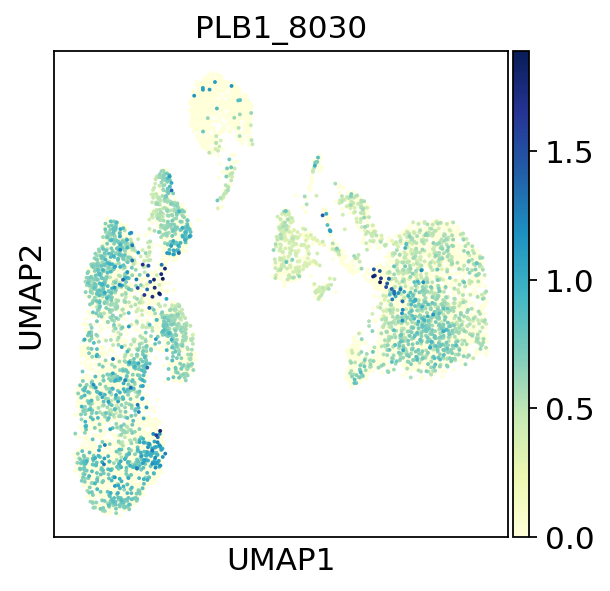

PLB1_8031


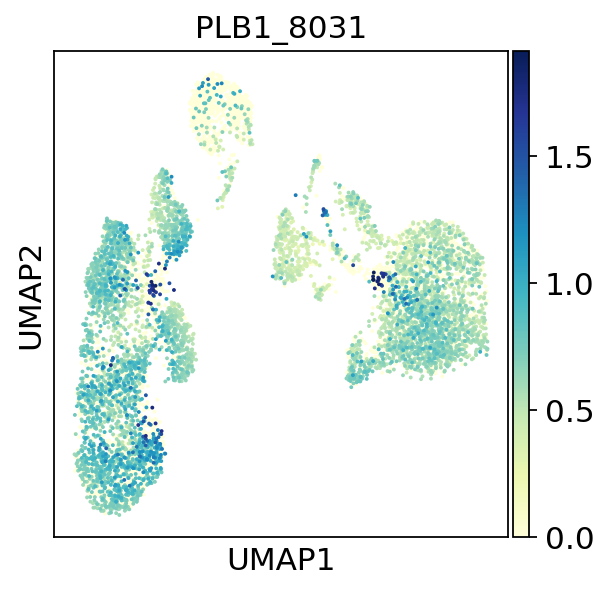

PLB1_8032


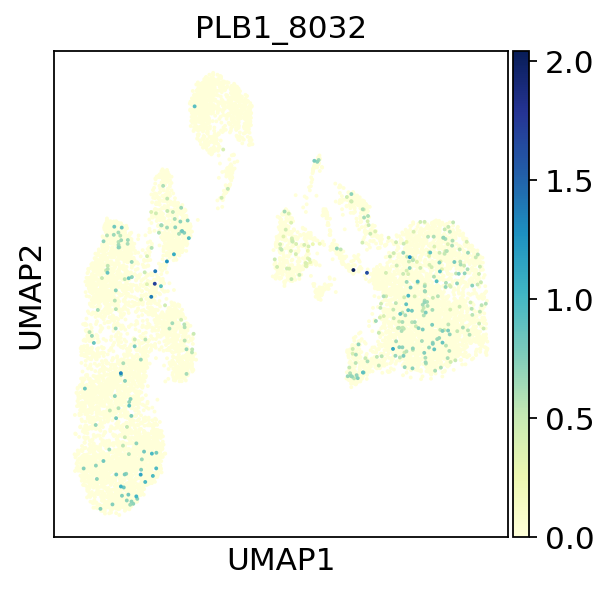

PLB1_8033


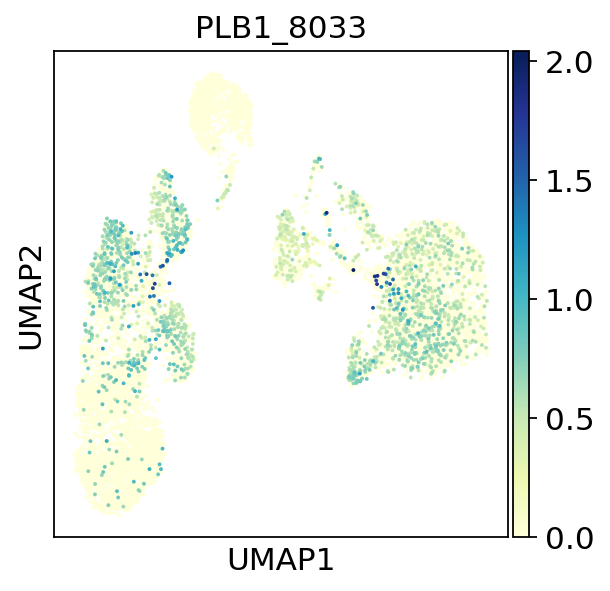

PLB1_8034


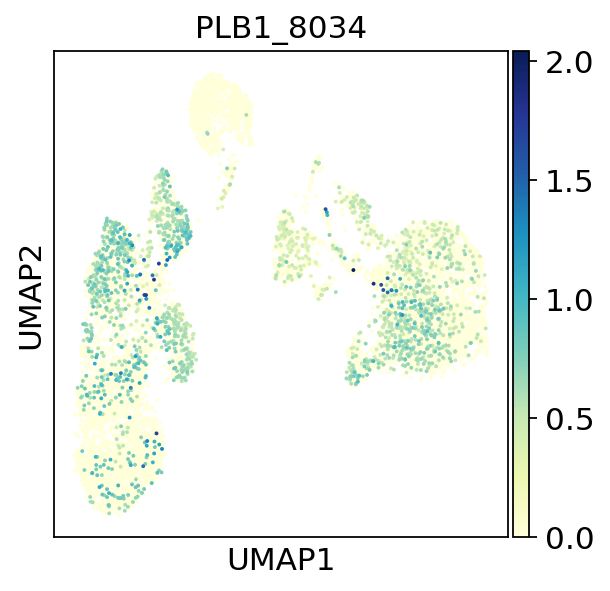

PLB1_8035


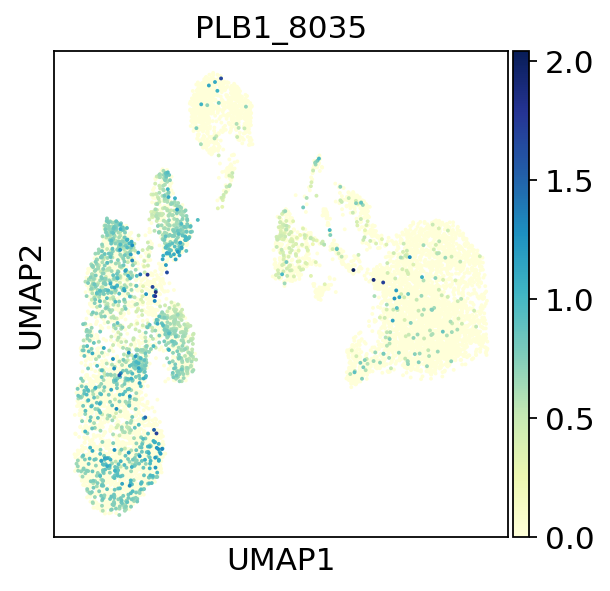

SPON2_17824


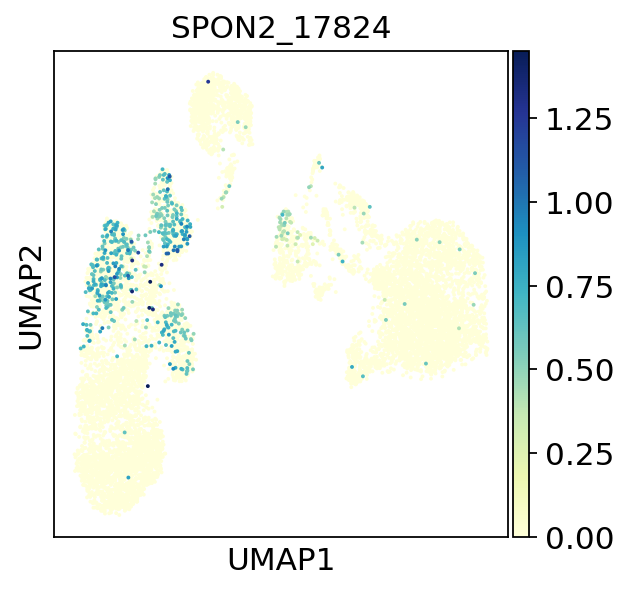

SPON2_17825


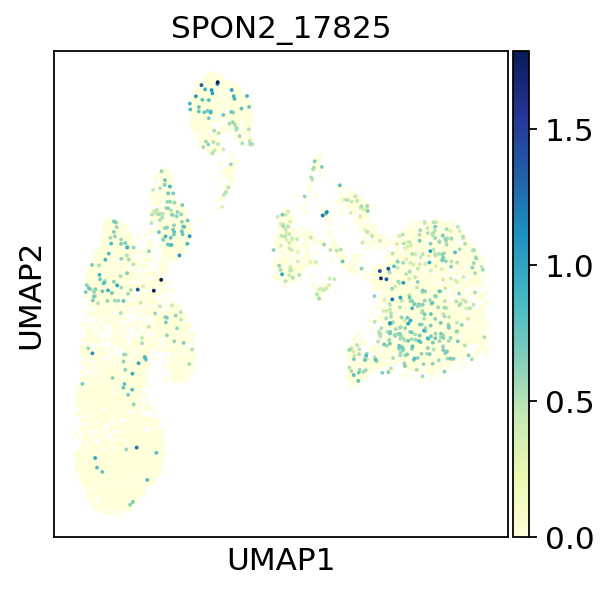

SPON2_17826


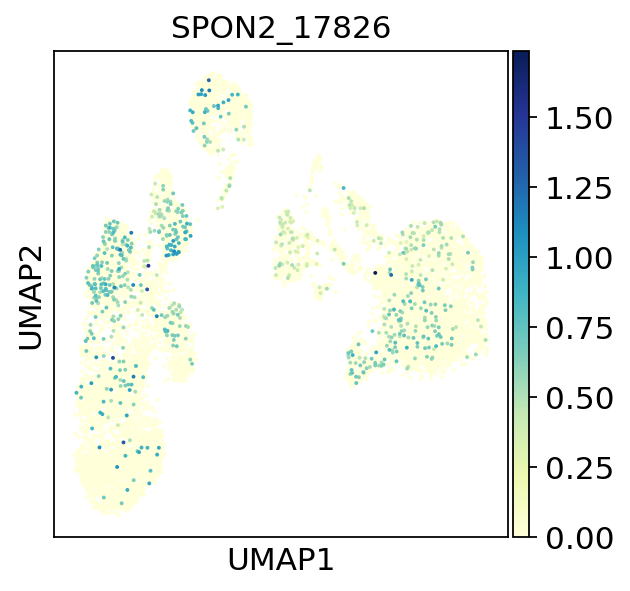

SPON2_17827


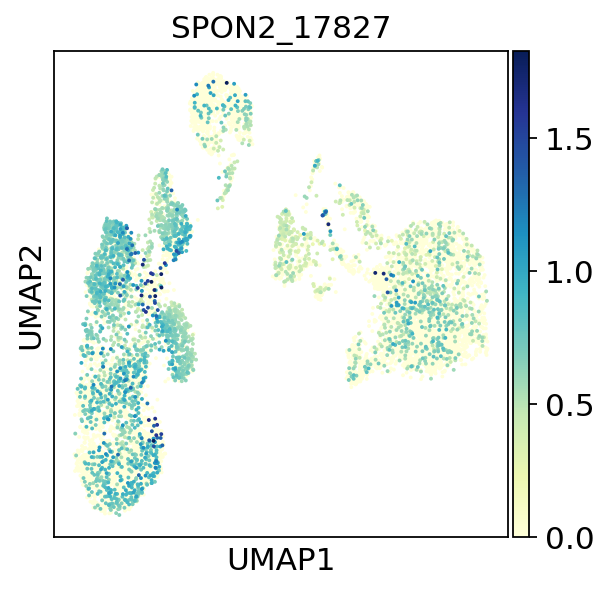

SPON2_17828


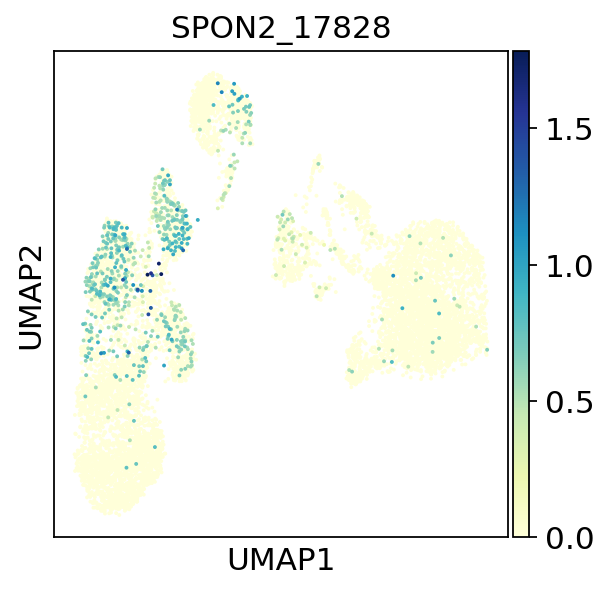

SPON2_17829


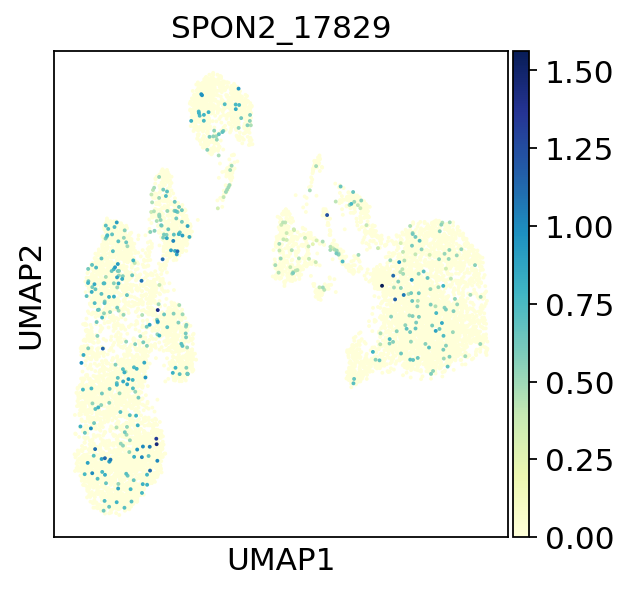

SPON2_17830


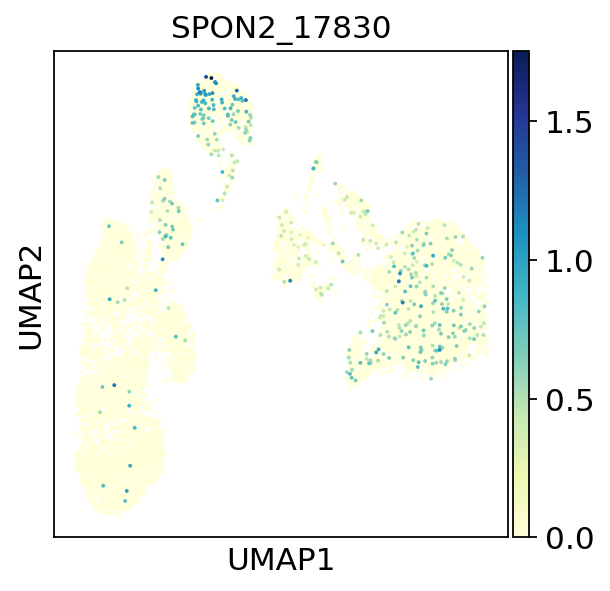

COL25A1_19622


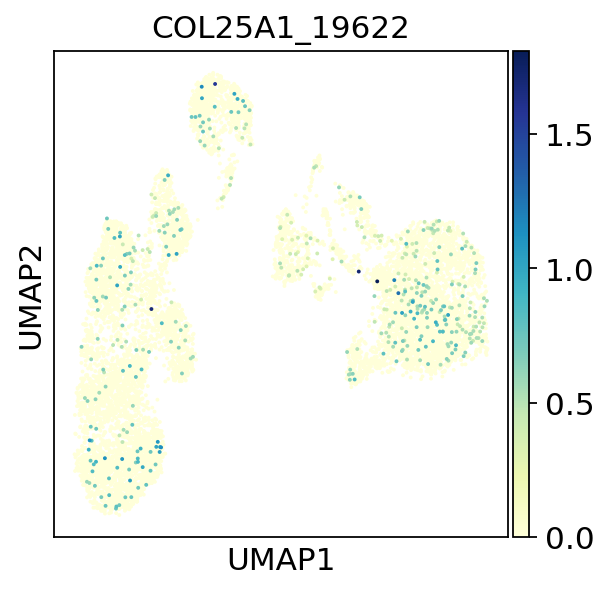

COL25A1_19623


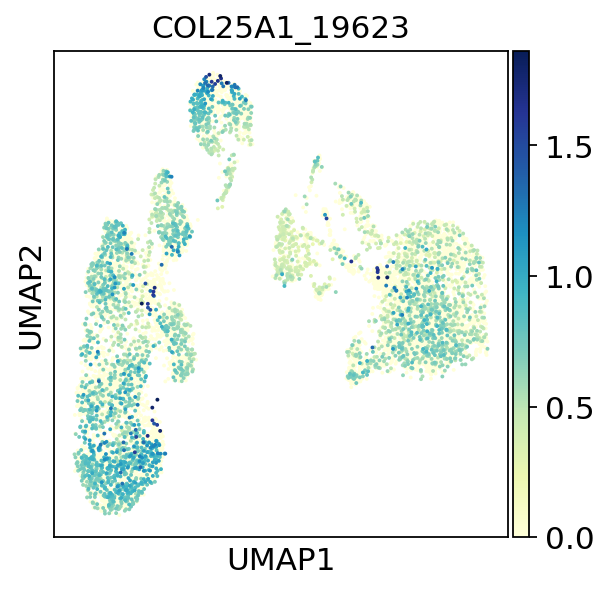

COL25A1_19624


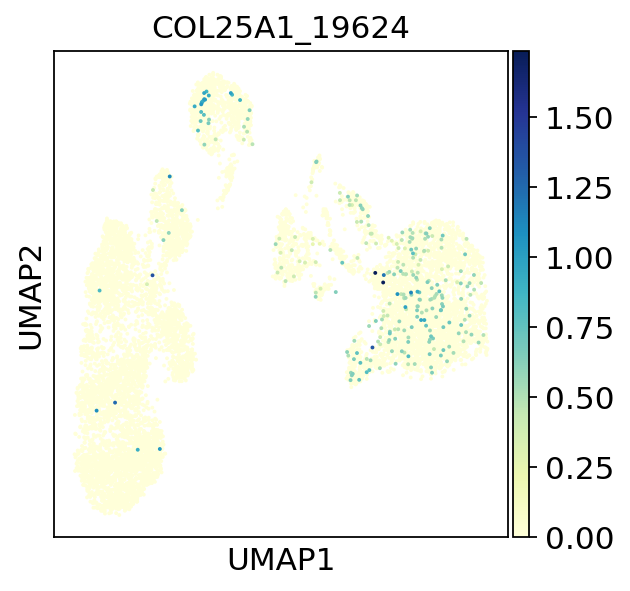

COL25A1_19625


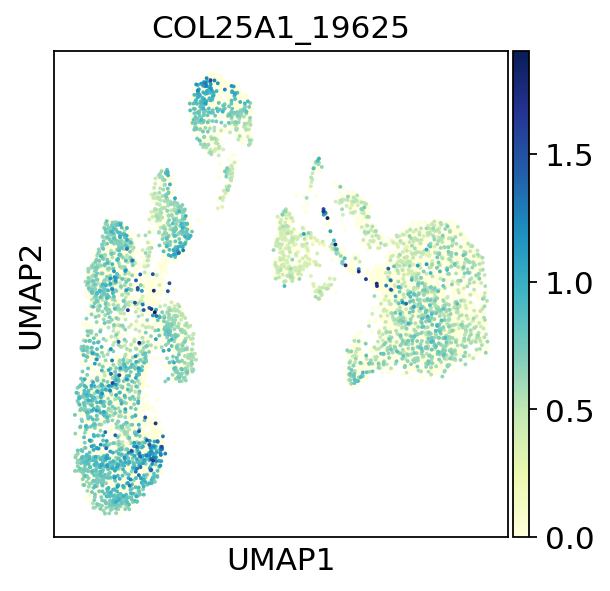

COL25A1_19626


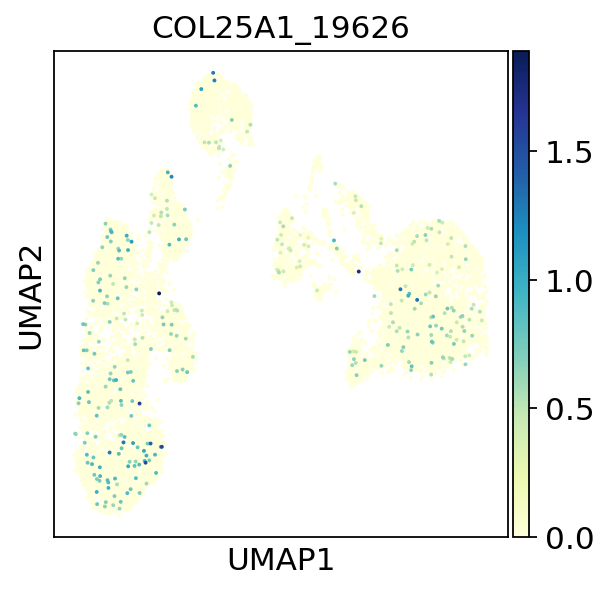

COL25A1_19627


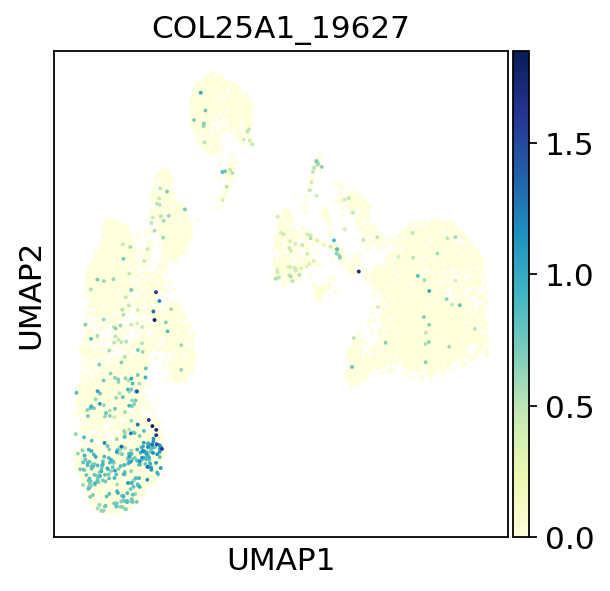

COL25A1_19628


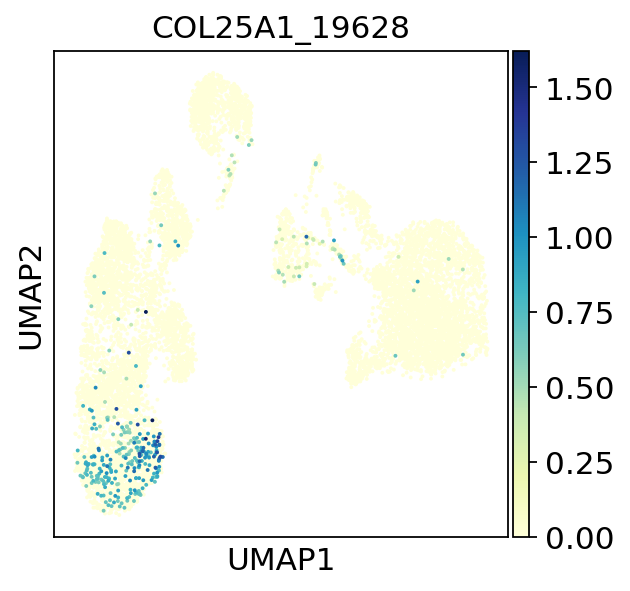

COL25A1_19629


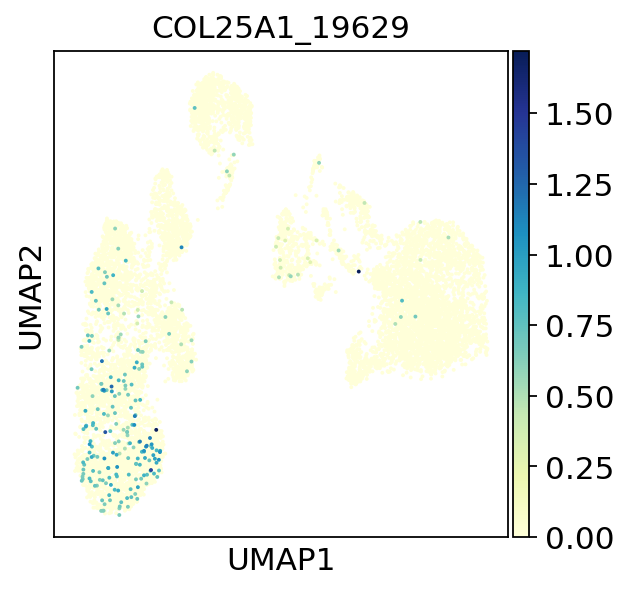

COL25A1_19630


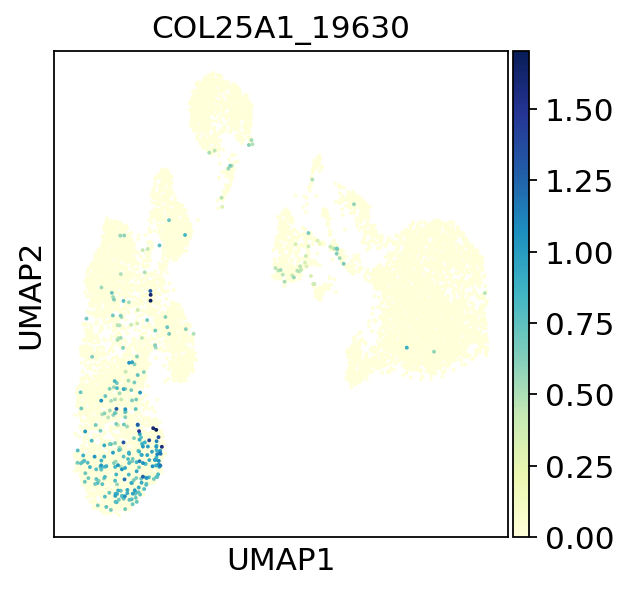

COL25A1_19631


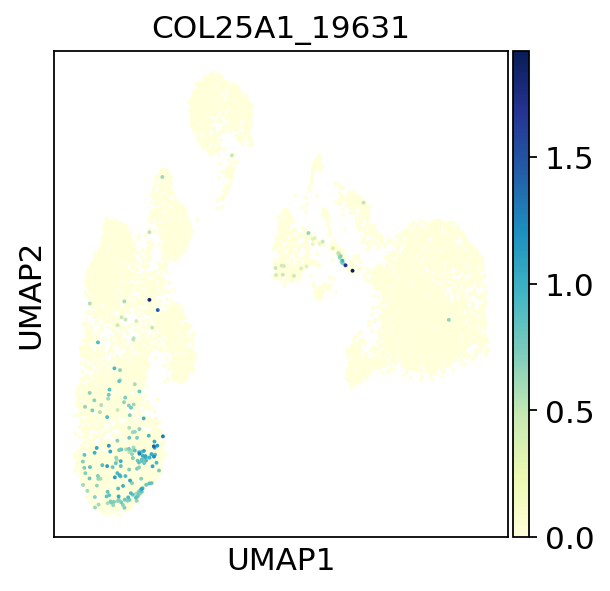

COL25A1_19632


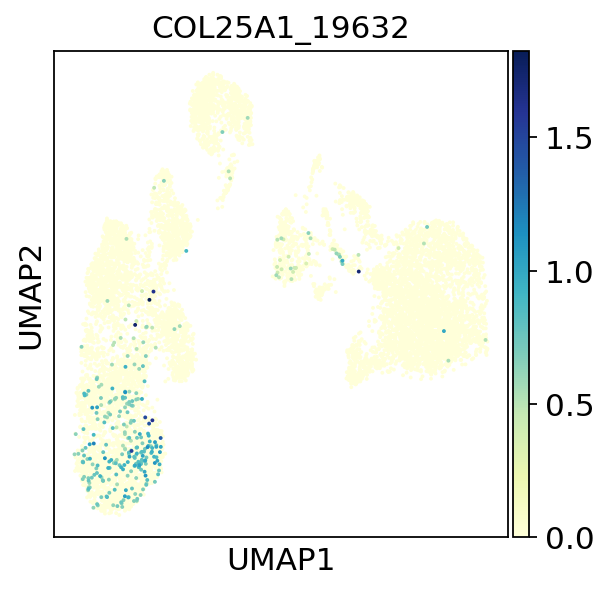

COL25A1_19633


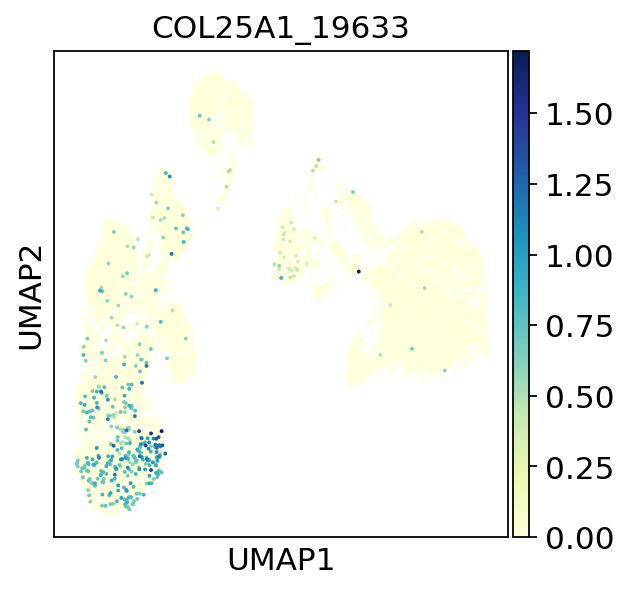

COL25A1_19634


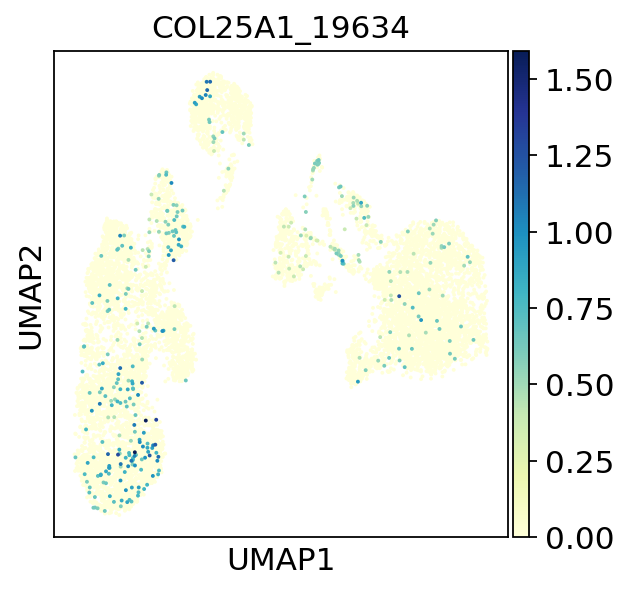

EYA4_27754


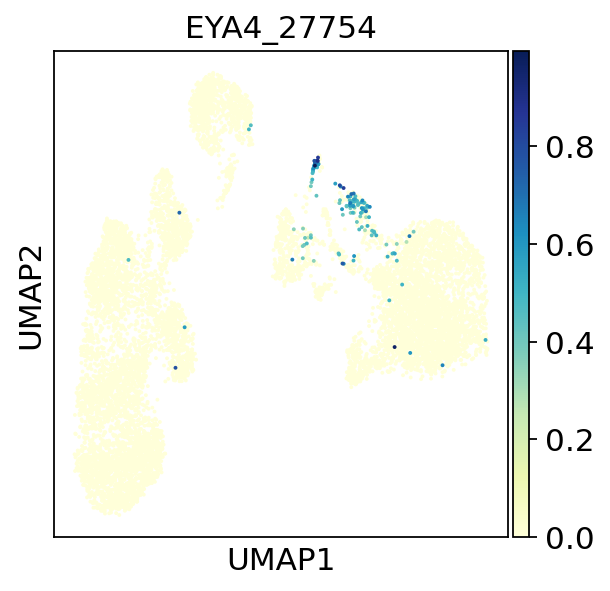

SVEP1;RNU6-1039P_37387


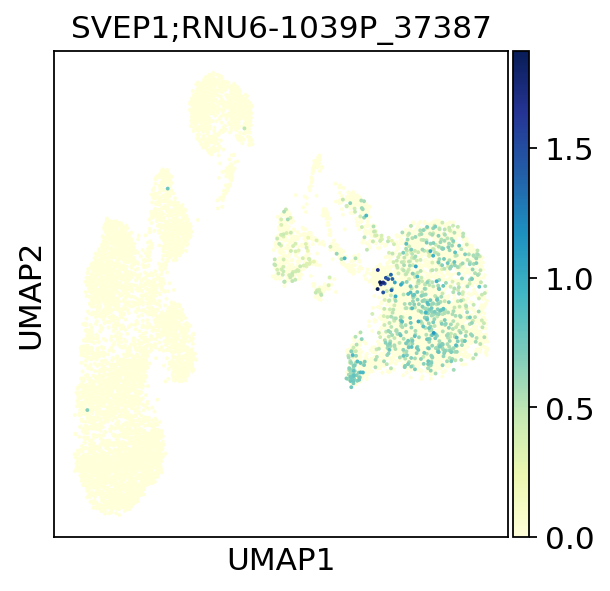

SVEP1_37388


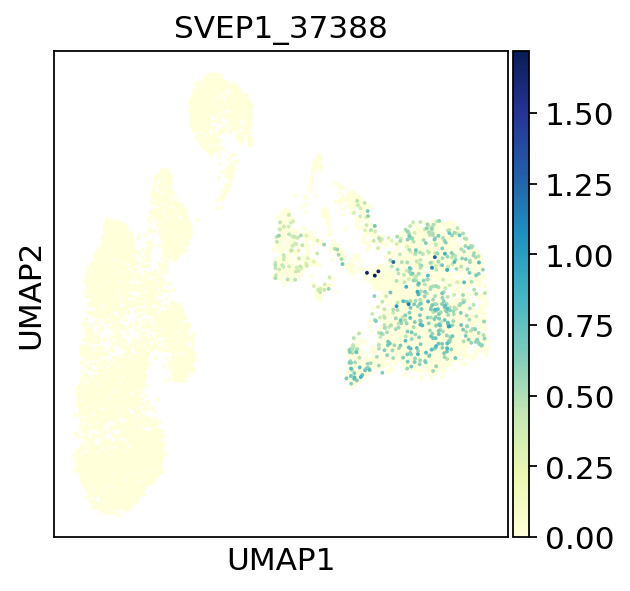

SVEP1_37389


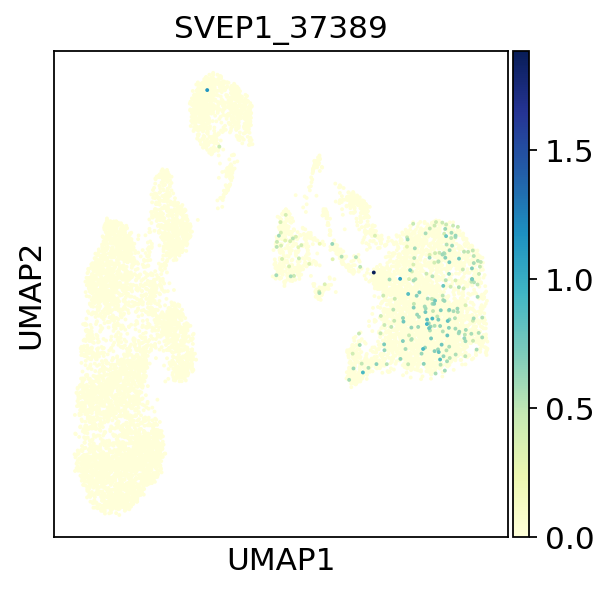

SVEP1_37390


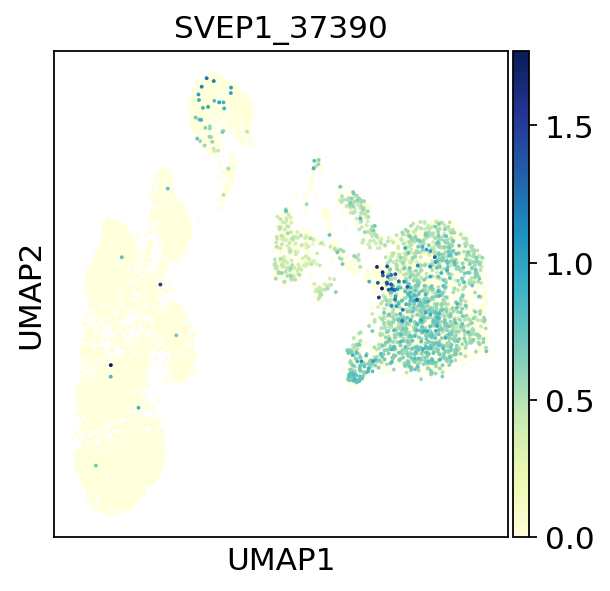

SVEP1_37391


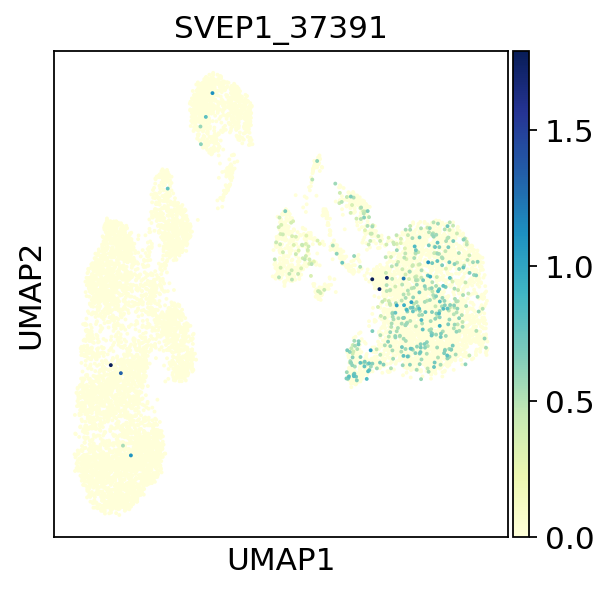

SVEP1_37392


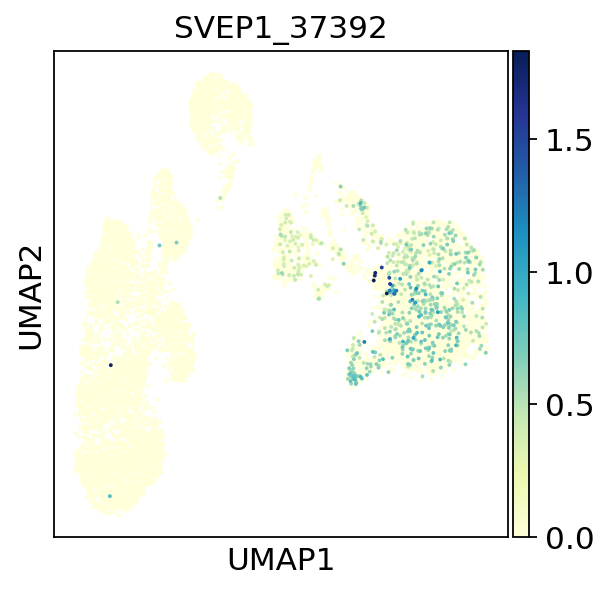

SVEP1_37393


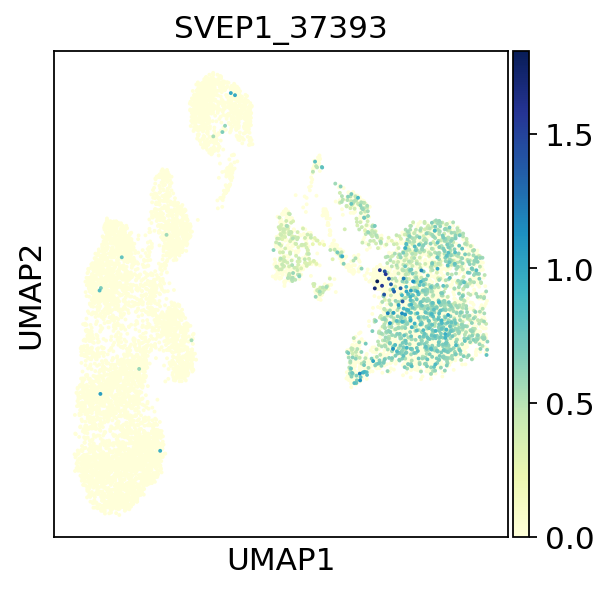

SVEP1_37394


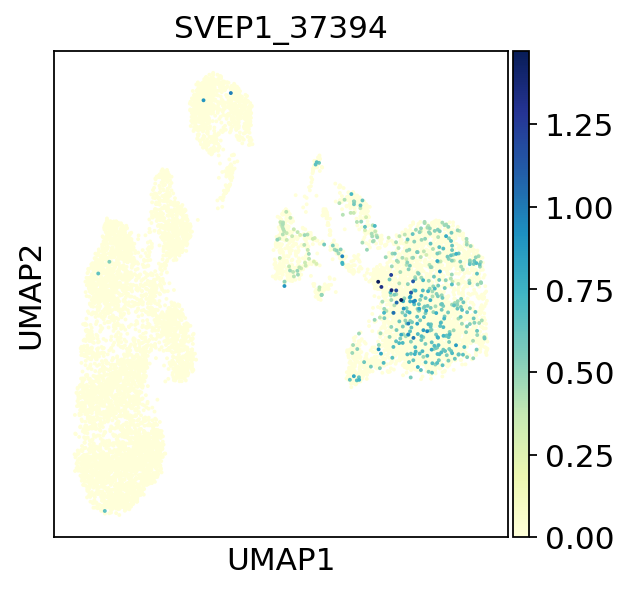

SVEP1_37395


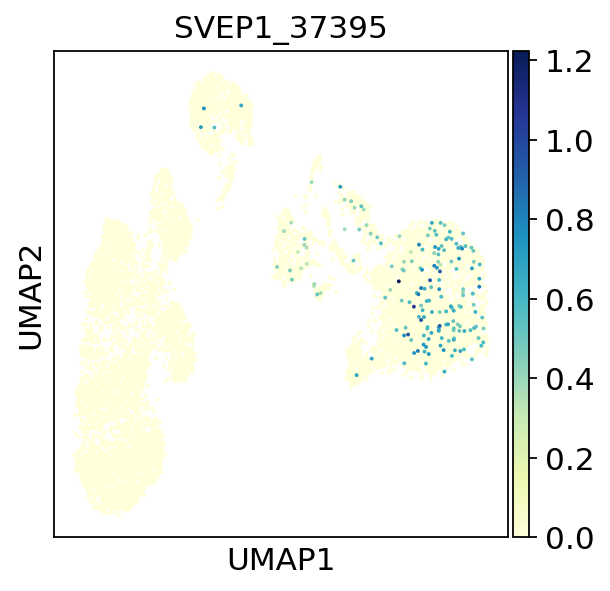

SVEP1_37396


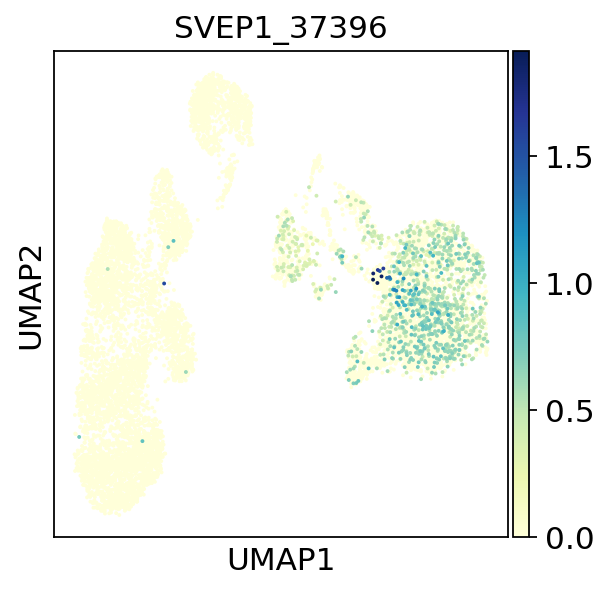

SVEP1_37397


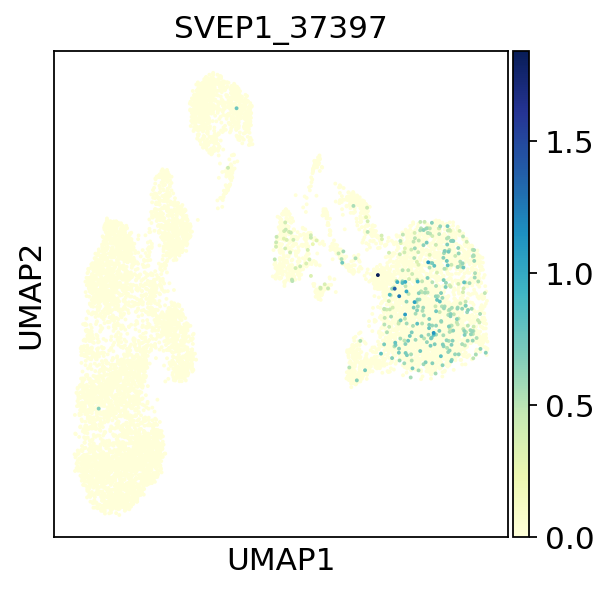

SVEP1_37398


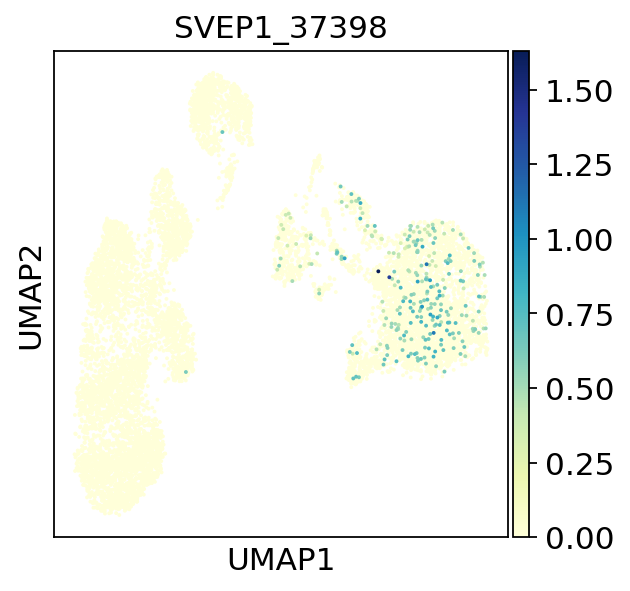

SVEP1_37399


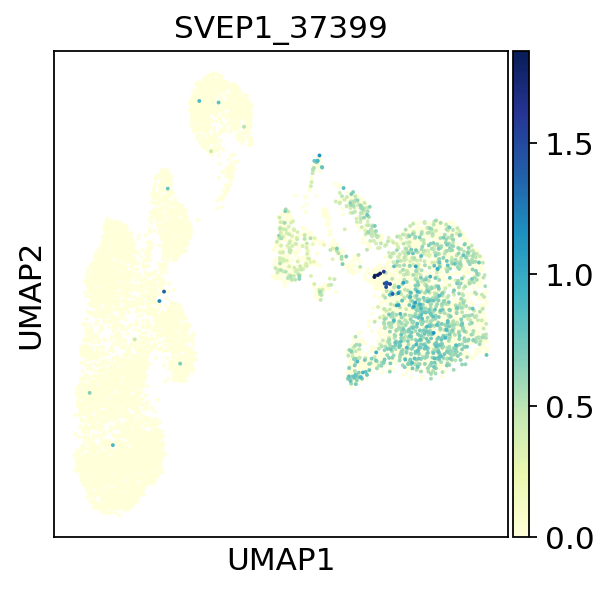

SVEP1_37400


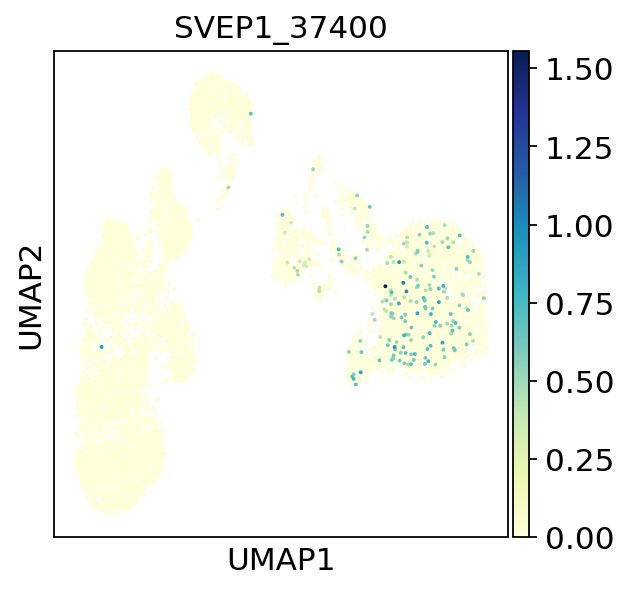

In [101]:
for n in adatax.var_names.tolist():
    if 'SVEP1' in n:
        print(n)
        sc.pl.umap(adatax, color=[n])
    elif 'EYA4' in n:
        print(n)
        sc.pl.umap(adatax, color=[n])
    elif 'COL25A1' in n:
        print(n)
        sc.pl.umap(adatax, color=[n])
    elif 'SPON2' in n:
        print(n)   
        sc.pl.umap(adatax, color=[n])
    elif 'PLB1' in n:
        print(n)
        sc.pl.umap(adatax, color=[n])

In [ ]:
sc.pl.umap(adatax, color=[#'SVEP1-203',
                          'EYA4-201',
                         'COL25A1-209',
                          'SPON2-222',
                          'PLB1-205'],
          save='peak_openess_10x_top_diff_genes.png')